In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
import os
from collections import defaultdict

# Experimental Constants

In [2]:
NUM_REPEATS = 10
TRAIN_SIZE = 5000

In [3]:
synthetic_results_path = "../results/synthetic_data/"
method_types = {'models_causal_impute': {'meta_learner': ['t_learner', 's_learner', 'x_learner', 'dr_learner'], 
                                              'dml_learner': ['double_ml', 'causal_forest']}, 
                'models_causal_survival': ['causal_survival_forest'], 
                'models_causal_survival_meta': ['t_learner_survival', 's_learner_survival', 'matching_learner_survival']}

imputation_methods = ['Pseudo_obs', 'Margin', 'IPCW-T']
survival_models = ['RandomSurvivalForest', 'DeepSurv', 'DeepHit']

# File Loading and Structure of Results Pickles

In [4]:
# Loop through all method types
for method_category, subtypes in method_types.items():
    print(f"\n=== {method_category} ===")
    
    if method_category == 'models_causal_impute':
        for subgroup, method_list in subtypes.items():
            for method in method_list:
                method_path = os.path.join(synthetic_results_path, method_category, subgroup, method)
                if not os.path.exists(method_path):
                    print(f"Path not found: {method_path}")
                    continue

                for imp in imputation_methods:
                    file_name = f"{method}_{imp}_repeats_{NUM_REPEATS}_train_{TRAIN_SIZE}.pkl"
                    file_path = os.path.join(method_path, file_name)
                    if os.path.exists(file_path):
                        print(file_path)
                        if subgroup == 'meta_learner':
                            file_path_impute_meta_meta = file_path
                        else:
                            file_path_impute_meta_dml = file_path
                    else:
                        print(f"Missing: {file_path}")

    elif method_category == 'models_causal_survival':
        for method in subtypes:
            method_path = os.path.join(synthetic_results_path, method_category, method)
            if not os.path.exists(method_path):
                print(f"Path not found: {method_path}")
                continue

            file_name = f"{method}_repeats_{NUM_REPEATS}_train_{TRAIN_SIZE}.pkl"
            file_path = os.path.join(method_path, file_name)
            if os.path.exists(file_path):
                print(file_path)
                file_path_causal_survival = file_path
            else:
                print(f"Missing: {file_path}")

    elif method_category == 'models_causal_survival_meta':
        for method in subtypes:
            method_path = os.path.join(synthetic_results_path, method_category, method)
            if not os.path.exists(method_path):
                print(f"Path not found: {method_path}")
                continue

            for surv in survival_models:
                file_name = f"{method}_{surv}_repeats_{NUM_REPEATS}_train_{TRAIN_SIZE}.pkl"
                file_path = os.path.join(method_path, file_name)
                if os.path.exists(file_path):
                    print(file_path)
                    file_path_causal_survival_meta = file_path
                else:
                    print(f"Missing: {file_path}")


=== models_causal_impute ===
../results/synthetic_data/models_causal_impute/meta_learner/t_learner/t_learner_Pseudo_obs_repeats_10_train_5000.pkl
../results/synthetic_data/models_causal_impute/meta_learner/t_learner/t_learner_Margin_repeats_10_train_5000.pkl
../results/synthetic_data/models_causal_impute/meta_learner/t_learner/t_learner_IPCW-T_repeats_10_train_5000.pkl
../results/synthetic_data/models_causal_impute/meta_learner/s_learner/s_learner_Pseudo_obs_repeats_10_train_5000.pkl
../results/synthetic_data/models_causal_impute/meta_learner/s_learner/s_learner_Margin_repeats_10_train_5000.pkl
../results/synthetic_data/models_causal_impute/meta_learner/s_learner/s_learner_IPCW-T_repeats_10_train_5000.pkl
../results/synthetic_data/models_causal_impute/meta_learner/x_learner/x_learner_Pseudo_obs_repeats_10_train_5000.pkl
../results/synthetic_data/models_causal_impute/meta_learner/x_learner/x_learner_Margin_repeats_10_train_5000.pkl
../results/synthetic_data/models_causal_impute/meta_le

# Aggregate results based on Best Average Ranking Previously Computed

In [ ]:
# Constants

# Setup
method_types = {
    'models_causal_impute': {
        'meta_learner': ['t_learner', 's_learner', 'x_learner', 'dr_learner'],
        'dml_learner': ['double_ml', 'causal_forest']
    },
    'models_causal_survival': ['causal_survival_forest'],
    'models_causal_survival_meta': ['t_learner_survival', 's_learner_survival', 'matching_learner_survival']
}

imputation_methods = ['Pseudo_obs', 'Margin', 'IPCW-T']
survival_models = ['RandomSurvivalForest', 'DeepSurv', 'DeepHit']

experiment_setups = ['RCT_0_5', 'RCT_0_05', 'e_X', 'e_X_U', 'e_X_no_overlap', 'e_X_info_censor', 'e_X_U_info_censor', 'e_X_no_overlap_info_censor']
scenarios = ['scenario_B', 'scenario_A', 'scenario_C', 'scenario_E', 'scenario_D']

In [6]:
# Modified final aggregation pass
best_candidates_list = [
    ("s_learner_survival", "DeepSurv"),
    ("matching_learner_survival", "DeepSurv"),
    ("double_ml", "Margin"),
    ("x_learner", "Margin", "Lasso"),
    ("causal_survival_forest",),
    ("s_learner", "Margin", "XGB"),
    ("t_learner", "Margin", "Lasso"),
    ("dr_learner", "Margin", "Lasso"),
    ("t_learner_survival", "DeepSurv"),
    ("causal_forest", "Margin"),
]

In [ ]:
# Helper function
def extract_repeat_metrics(data, path_keys, metrics_of_interest=['ate_true', 'ate_pred', 'cate_mse', 'ate_bias']):
    result = defaultdict(list)
    for repeat_key in data:
        if repeat_key == "average":
            continue
        for metric in data[repeat_key]:
            if metric not in metrics_of_interest:
                continue
            result[metric].append(data[repeat_key][metric])
    return dict(result)

# Initialize aggregation dictionary
aggregated_results = {scen: {exp: defaultdict(dict) for exp in experiment_setups} for scen in scenarios}

# Processing files
for method_category, subtypes in method_types.items():
    if method_category == 'models_causal_impute':
        for subgroup, method_list in subtypes.items():
            for method in method_list:
                for imp in imputation_methods:
                    file_name = f"{method}_{imp}_repeats_{NUM_REPEATS}_train_{TRAIN_SIZE}.pkl"
                    file_path = os.path.join(synthetic_results_path, method_category, subgroup, method, file_name)
                    if not os.path.exists(file_path):
                        continue
                    with open(file_path, "rb") as f:
                        data = pickle.load(f)
                    for exp in experiment_setups:
                        if exp not in data:
                            continue
                        for scen in scenarios:
                            if scen not in data[exp]:
                                continue
                            scenario_data = data[exp][scen]
                            if subgroup == 'meta_learner':
                                # Collect all (imp, base_model) combinations — not just best one
                                for base_model, content in scenario_data.items():
                                    if "average" not in content or "mean_cate_mse" not in content["average"]:
                                        continue
                                    mse = content["average"]["mean_cate_mse"]
                                    metrics = extract_repeat_metrics(content, [])
                                    current = aggregated_results[scen][exp][f"{method_category}/{subgroup}"].setdefault(method, {})
                                    current.setdefault("best_candidates", []).append((imp, base_model, mse, metrics))
                            else:  # dml_learner
                                mse = scenario_data["average"]["mean_cate_mse"]
                                metrics = extract_repeat_metrics(scenario_data, [])
                                current = aggregated_results[scen][exp][f"{method_category}/{subgroup}"].setdefault(method, {})
                                current.setdefault("best_candidates", []).append((imp, mse, metrics))

    elif method_category == 'models_causal_survival':
        for method in subtypes:
            file_name = f"{method}_repeats_{NUM_REPEATS}_train_{TRAIN_SIZE}.pkl"
            file_path = os.path.join(synthetic_results_path, method_category, method, file_name)
            if not os.path.exists(file_path):
                continue
            with open(file_path, "rb") as f:
                data = pickle.load(f)
            for exp in experiment_setups:
                if exp not in data:
                    continue
                for scen in scenarios:
                    if scen not in data[exp]:
                        continue
                    metrics = extract_repeat_metrics(data[exp][scen], [])
                    aggregated_results[scen][exp][method_category][method] = metrics

    elif method_category == 'models_causal_survival_meta':
        for method in subtypes:
            for surv_model in survival_models:
                file_name = f"{method}_{surv_model}_repeats_{NUM_REPEATS}_train_{TRAIN_SIZE}.pkl"
                file_path = os.path.join(synthetic_results_path, method_category, method, file_name)
                if not os.path.exists(file_path):
                    continue
                with open(file_path, "rb") as f:
                    data = pickle.load(f)
                for exp in experiment_setups:
                    if exp not in data:
                        continue
                    for scen in scenarios:
                        if scen not in data[exp]:
                            continue
                        mse = data[exp][scen]["average"]["mean_cate_mse"]
                        metrics = extract_repeat_metrics(data[exp][scen], [])
                        current = aggregated_results[scen][exp][method_category].setdefault(method, {})
                        current.setdefault("best_candidates", []).append((surv_model, mse, metrics))

# Normalize and prepare the best candidate lookup
candidate_lookup = set(tuple(map(str.lower, entry)) for entry in best_candidates_list)

for scen in aggregated_results:
    for exp in aggregated_results[scen]:
        for cat in aggregated_results[scen][exp]:
            for method in list(aggregated_results[scen][exp][cat].keys()):
                method_entry = aggregated_results[scen][exp][cat][method]

                # Handle methods with best_candidates
                if "best_candidates" in method_entry:
                    candidates = method_entry["best_candidates"]
                    if not candidates or not isinstance(candidates[0], tuple):
                        continue

                    selected = None
                    method_lc = method.lower()

                    if cat.endswith("meta_learner"):
                        for entry in candidates:
                            imp, base, _, metrics = entry
                            if (method_lc, imp.lower(), base.lower()) in candidate_lookup:
                                selected = entry
                                break

                    elif cat.endswith("dml_learner"):
                        for entry in candidates:
                            imp, _, metrics = entry
                            if (method_lc, imp.lower()) in candidate_lookup:
                                selected = entry
                                break

                    elif cat == "models_causal_survival_meta":
                        for entry in candidates:
                            surv_model, _, metrics = entry
                            if (method_lc, surv_model.lower()) in candidate_lookup:
                                selected = entry
                                break

                    if selected:
                        method_entry.clear()
                        if cat.endswith("meta_learner"):
                            imp, base, _, metrics = selected
                            method_entry["best_imputation"] = imp
                            method_entry["best_base_model"] = base
                        elif cat.endswith("dml_learner"):
                            imp, _, metrics = selected
                            method_entry["best_imputation"] = imp
                        elif cat == "models_causal_survival_meta":
                            surv_model, _, metrics = selected
                            method_entry["best_base_survival"] = surv_model
                        method_entry.update(metrics)
                    else:
                        print(f"[WARN] No match found for {method} in scenario {scen}, experiment {exp}")

                # Handle direct metric entries (e.g., causal_survival_forest, causal_forest)
                else:
                    method_lc = method.lower()
                    if (method_lc,) not in candidate_lookup:
                        # If not a listed one, remove it
                        aggregated_results[scen][exp][cat][method] = {}



                    
aggregated_results

# Adjust True ATE and ATE Bias (Correction)

In [ ]:
TRUE_ATE = {('RCT_0_5', 'scenario_B'): 0.124969, ('RCT_0_5', 'scenario_A'): 0.163441, ('RCT_0_5', 'scenario_C'): 0.74996,
            ('RCT_0_5', 'scenario_E'): 0.7537, ('RCT_0_5', 'scenario_D'): 0.723925,
            ('RCT_0_05', 'scenario_B'): 0.124969, ('RCT_0_05', 'scenario_A'): 0.163441, ('RCT_0_05', 'scenario_C'): 0.74996,
            ('RCT_0_05', 'scenario_E'): 0.7537, ('RCT_0_05', 'scenario_D'): 0.723925,
            ('e_X', 'scenario_B'): 0.124969, ('e_X', 'scenario_A'): 0.163441, ('e_X', 'scenario_C'): 0.74996,
            ('e_X', 'scenario_E'): 0.7537, ('e_X', 'scenario_D'): 0.723925,
            ('e_X_U', 'scenario_B'): 0.131728, ('e_X_U', 'scenario_A'): 0.003744, ('e_X_U', 'scenario_C'): 0.74036,
            ('e_X_U', 'scenario_E'): 0.74032, ('e_X_U', 'scenario_D'): 0.830668,
            ('e_X_no_overlap', 'scenario_B'): 0.124969, ('e_X_no_overlap', 'scenario_A'): 0.163441, ('e_X_no_overlap', 'scenario_C'): 0.74996,
            ('e_X_no_overlap', 'scenario_E'): 0.7537, ('e_X_no_overlap', 'scenario_D'): 0.723925,
            ('e_X_info_censor', 'scenario_B'): 0.124969, ('e_X_info_censor', 'scenario_A'): 0.163441, ('e_X_info_censor', 'scenario_C'): 0.74996,
            ('e_X_info_censor', 'scenario_E'): 0.7537, ('e_X_info_censor', 'scenario_D'): 0.723925,
            ('e_X_U_info_censor', 'scenario_B'): 0.131728, ('e_X_U_info_censor', 'scenario_A'): 0.003744, ('e_X_U_info_censor', 'scenario_C'): 0.74036,
            ('e_X_U_info_censor', 'scenario_E'): 0.74032, ('e_X_U_info_censor', 'scenario_D'): 0.830668,
            ('e_X_no_overlap_info_censor', 'scenario_B'): 0.124969, ('e_X_no_overlap_info_censor', 'scenario_A'): 0.163441, 
            ('e_X_no_overlap_info_censor', 'scenario_C'): 0.74996, ('e_X_no_overlap_info_censor', 'scenario_E'): 0.7537, 
            ('e_X_no_overlap_info_censor', 'scenario_D'): 0.723925}

In [9]:
for scen in aggregated_results:
    for exp in aggregated_results[scen]:
        for cat in aggregated_results[scen][exp]:
            for method in aggregated_results[scen][exp][cat]:
                true_ate_test_repeats = aggregated_results[scen][exp][cat][method]['ate_true']
                predicted_ate_test_repeats = aggregated_results[scen][exp][cat][method]['ate_pred']
                true_ate_population = TRUE_ATE.get((exp, scen), None)

                adjusted_ate_bias = np.array(predicted_ate_test_repeats) - true_ate_population
                adjusted_true_ate = np.ones_like(true_ate_test_repeats) * true_ate_population
                
                aggregated_results[scen][exp][cat][method]['ate_bias'] = adjusted_ate_bias
                aggregated_results[scen][exp][cat][method]['ate_true'] = adjusted_true_ate
                # break
            # break
        # break
    # break


# Plotting Helper Functions

In [10]:
# Updated mapping for prettier and consistent experiment names
pretty_experiment_names = {
    "RCT_0_5": "RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",
    "RCT_0_05": "RCT: ✓ (5%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",
    "e_X": "RCT: ✗, Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",
    "e_X_U": "RCT: ✗, Ignorability: ✗, Positivity: ✓, Ignorable Censoring: ✓",
    "e_X_no_overlap": "RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✓",
    "e_X_info_censor": "RCT: ✗, Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✗",
    "e_X_U_info_censor": "RCT: ✗, Ignorability: ✗, Positivity: ✓, Ignorable Censoring: ✗",
    "e_X_no_overlap_info_censor": "RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗"
}

# Mapping for pretty method names
pretty_method_names_plotting = {
    "t_learner": "T-Learner",
    "s_learner": "S-Learner",
    "x_learner": "X-Learner",
    "dr_learner": "DR-Learner",
    "double_ml": "Double-ML",
    "causal_forest": "Causal\nForest",
    "causal_survival_forest": "Causal\nSurvival\nForest",
    "t_learner_survival": "T-Learner\nSurvival",
    "s_learner_survival": "S-Learner\nSurvival",
    "matching_learner_survival": "Matching\nSurvival"
}

pretty_method_names = {
    "t_learner": "T-Learner",
    "s_learner": "S-Learner",
    "x_learner": "X-Learner",
    "dr_learner": "DR-Learner",
    "double_ml": "Double-ML",
    "causal_forest": "Causal Forest",
    "causal_survival_forest": "Causal Survival Forest",
    "t_learner_survival": "T-Learner Survival",
    "s_learner_survival": "S-Learner Survival",
    "matching_learner_survival": "Matching Survival"
}

In [11]:
def aggregated_results_df(aggregated_results, scenario_key, skip_experiments_list=None, metrics=["cate_mse", "ate_bias", "ate_pred", "ate_true"]):
    """
    Convert the aggregated results into a DataFrame for easier manipulation and visualization.
    """
    # Check if the scenario key exists in the aggregated results
    if scenario_key not in aggregated_results:
        print(f"Scenario '{scenario_key}' not found in aggregated results.")
        return

    # Prepare the DataFrame for plotting
    plot_data = []
    for exp_key in aggregated_results[scenario_key]:
        if (skip_experiments_list is not None) and (exp_key in skip_experiments_list):
            continue
        for category in aggregated_results[scenario_key][exp_key]:
            for method in aggregated_results[scenario_key][exp_key][category]:
                entry = aggregated_results[scenario_key][exp_key][category][method]
                
                num_rows_to_add = len(entry["cate_mse"])

                for row_ids in range(num_rows_to_add):
                    row = {
                        "experiment": exp_key,
                        "method": method,
                        "category": category,
                        "best_imputation": entry.get("best_imputation", None),
                        "best_base_model": entry.get("best_base_model", None),
                        "best_base_survival": entry.get("best_base_survival", None),
                    }
                    for metric in metrics:
                        if metric in entry:
                            row[metric] = entry[metric][row_ids]
                        else:
                            row[metric] = None
                    plot_data.append(row)

    df_plot = pd.DataFrame(plot_data)
    # Update this if not done already
    df_plot["method_pretty"] = df_plot["method"].map(pretty_method_names_plotting)
    df_plot["method_pretty_raw"] = df_plot["method"].map(pretty_method_names)

    return df_plot

In [12]:
def pretty_results_table(df_plot):
    # Wider display for specific columns
    pd.set_option('display.max_colwidth', None)  # Show full content of any column

    df_table = df_plot.copy()

    # Drop the 'category' column
    df_table = df_table.drop(columns=["category"])

    # Map experiment names
    df_table['experiment_id'] = df_table['experiment']
    df_table['experiment'] = df_table['experiment'].map(pretty_experiment_names)

    # Group and aggregate
    agg_df = df_table.groupby(["experiment_id", "method_pretty_raw"]).agg(
        cate_mse_mean=("cate_mse", "mean"),
        cate_mse_std=("cate_mse", "std"),
        ate_bias_mean=("ate_bias", "mean"),
        ate_bias_std=("ate_bias", "std"),
        experiment=("experiment", "first"),
        best_imputation=("best_imputation", "first"),
        best_base_model=("best_base_model", "first"),
        best_base_survival=("best_base_survival", "first")
    ).reset_index()

    # Format into "mean ± std"
    agg_df["cate_mse"] = agg_df.apply(
        lambda row: f"{row['cate_mse_mean']:.3f} ± {row['cate_mse_std']:.3f}", axis=1
    )
    agg_df["ate_bias"] = agg_df.apply(
        lambda row: f"{row['ate_bias_mean']:.3f} ± {row['ate_bias_std']:.3f}", axis=1
    )

    # Optionally drop the separate mean and std columns
    agg_df = agg_df.drop(columns=["cate_mse_mean", "cate_mse_std", "ate_bias_mean", "ate_bias_std"])

    # Order based on pretty_experiment_names
    experiment_order = [pretty_experiment_names[key] for key in pretty_experiment_names]
    # Order based on pretty_method_names
    method_order = list(pretty_method_names.values())

    agg_df["experiment"] = pd.Categorical(
        agg_df["experiment"], categories=experiment_order, ordered=True
    )
    agg_df["method_pretty_raw"] = pd.Categorical(
        agg_df["method_pretty_raw"], categories=method_order, ordered=True
    )

    cols = list(agg_df.columns)
    i, j = cols.index("method_pretty_raw"), cols.index("experiment")
    cols[i], cols[j] = cols[j], cols[i]
    agg_df = agg_df[cols]

    agg_df = agg_df.sort_values(by=["experiment", "method_pretty_raw"]).reset_index(drop=True)
    agg_df.rename(columns={"method_pretty_raw": "method"}, inplace=True)
    agg_df["best_base_model"] = agg_df["best_base_model"].fillna(" ")
    agg_df["best_base_survival"] = agg_df["best_base_survival"].fillna(" ")
    agg_df["best_imputation"] = agg_df["best_imputation"].fillna(" ")
    return agg_df

In [13]:
import seaborn as sns
import matplotlib.pyplot as plt

def plot_aggregated_experiment_results(scenario_key, df_plot_raw, skip_experiments_list=None, 
                                       metric="cate_mse", y_lim=None, title_include_scenario=False):
    if scenario_key not in aggregated_results:
        print(f"Scenario '{scenario_key}' not found in aggregated results.")
        return

    # Color settings
    category_palette_alpha = {
        "models_causal_impute/meta_learner": (31/255, 119/255, 180/255, 0.6),   # Blue, light
        "models_causal_impute/dml_learner": (8/255, 77/255, 117/255, 0.8),      # Blue, dark
        "models_causal_survival": (44/255, 160/255, 44/255, 0.8),               # Green
        "models_causal_survival_meta": (214/255, 39/255, 40/255, 0.8)           # Red
    }

    category_bg = {
        "models_causal_impute/meta_learner": (208/255, 230/255, 252/255),      # Very light blue
        "models_causal_impute/dml_learner": (198/255, 220/255, 242/255),       # Very light blue
        "models_causal_survival": (220/255, 245/255, 220/255),                 # Very light green
        "models_causal_survival_meta": (255/255, 225/255, 225/255)             # Very light red
    }

    df_plot = df_plot_raw.copy()
    df_plot["color"] = df_plot["category"].map(category_palette_alpha)
    df_plot["bg_color"] = df_plot["category"].map(category_bg)

    if y_lim is None:
        y_min = df_plot[metric].min()
        y_max = df_plot[metric].max()
        y_margin = (y_max - y_min) * 0.1
        y_lim = (y_min - y_margin, y_max + y_margin)

    # sns.set(style="whitegrid", font_scale=1.2)
    plt.rcParams["figure.dpi"] = 300

    for exp_key, exp_title in pretty_experiment_names.items():
        if skip_experiments_list and exp_key in skip_experiments_list:
            continue

        exp_df = df_plot[df_plot["experiment"] == exp_key]
        methods = exp_df["method_pretty"].unique()
        true_ate = exp_df["ate_true"]
        exp_title = f"({scenario_key}) {exp_title}" if title_include_scenario else exp_title

        plt.figure(figsize=(11, 3))
        ax = plt.gca()

        # --- Y limits ---
        if y_lim is False:
            y_min = exp_df[metric].min()
            y_max = exp_df[metric].max()
            y_margin = (y_max - y_min) * 0.1
            ax.set_ylim((y_min - y_margin, y_max + y_margin))
        else:
            ax.set_ylim(y_lim)

        ax.set_xlim(-0.5, len(methods) - 0.5)

        # --- X ticks ---
        ax.set_xticks(range(len(methods)))
        ax.set_xticklabels(methods, rotation=-30, fontsize=14)

        # --- Gridlines ---
        ax.xaxis.grid(True, linestyle="--", linewidth=0.5)
        ax.yaxis.grid(True, linestyle="--", linewidth=0.5)

        # --- Background spans for contiguous color blocks (no white lines) ---
        # --- Perfect seamless background spans for contiguous blocks ---
        epsilon = 1  # small overlap to prevent white gaps
        bg_colors = [exp_df[exp_df["method_pretty"] == method]["bg_color"].iloc[0] for method in methods]

        start = 0
        for i in range(1, len(bg_colors)):
            if bg_colors[i] != bg_colors[i - 1]:
                # slightly overlap spans
                ax.axvspan(start - 0.5, i - 0.5 + epsilon, facecolor=bg_colors[i - 1], zorder=0, edgecolor='black', linewidth=0)
                start = i
        # draw the last background block
        ax.axvspan(start - 0.5, len(bg_colors) - 0.5 + epsilon, facecolor=bg_colors[-1], zorder=0, edgecolor='black', linewidth=0)

        # --- Boxplots ---
        for i, method in enumerate(methods):
            method_data = exp_df[exp_df["method_pretty"] == method]
            y_vals = method_data[metric].values
            color = method_data["color"].iloc[0] if not method_data.empty else (0.7, 0.7, 0.7, 0.7)

            sns.boxplot(
                x=[i] * len(y_vals),
                y=y_vals,
                ax=ax,
                color=color,
                width=0.3,  # thinner
                showcaps=True,
                boxprops=dict(facecolor=color, edgecolor='black', linewidth=1.0),
                whiskerprops=dict(color='black', linewidth=0.8),
                medianprops=dict(color='black', linewidth=1.2),
                showfliers=False
            )

            ax.scatter(
                [i] * len(y_vals), y_vals,
                color=color,
                # edgecolor='black',
                s=10,
                zorder=1,
                alpha=0.7
            )

        # --- Reference line for true ATE ---
        if metric in {"ate_pred", "ate_true"}:
            ax.axhline(y=true_ate.mean(), color='black', linestyle='--', linewidth=1.5, label="True ATE")
            ax.legend(loc="upper right", fontsize=12)
        
        if metric == "ate_bias":
            ax.axhline(y=0, color='black', linestyle='--', linewidth=1.5, label="No Bias", zorder=0, alpha=0.4)
            # ax.legend(loc="upper right", fontsize=12)

        # --- Axis labels & title ---
        # ax.set_title(exp_title, pad=15)
        y_label_map = {
            "cate_mse": "CATE MSE",
            "ate_true": "True ATE",
            "ate_pred": "Pred ATE",
            "ate_bias": "ATE Bias"
        }
        ax.set_ylabel(y_label_map.get(metric, metric), fontsize=14, fontweight='bold')
        ax.set_xlabel("")

        # plt.yticks(fontsize=12)

        plt.tight_layout()

        plt.savefig(f"figure_results/{metric}/{scenario_key}_{exp_key}_{metric}.pdf", bbox_inches='tight')

        plt.show()


# Figure Generation Parameters

(Metric, Experiments to Exclude, Y-Axis Constant)

In [ ]:
skip_experiments_list = [] #['RCT_0_5', 'RCT_0_05']
# metric = "ate_bias"  # Choose from ['cate_mse', 'ate_true', 'ate_pred', 'ate_bias']
# y_lim = None # Set to False to use individual y-limits for each plot or None for global limits

Y_LIM = {"cate_mse": {'scenario_B': (0.55, 0.9),
                     'scenario_A': (10, 18.5),
                     'scenario_C': (13.75, 16.5),
                     'scenario_E': (15.75, 18.5),
                    #  'scenario_8': (15.75, 20.75),
                     'scenario_D': (35, 56)},
         "ate_bias": {'scenario_B': None,
                      'scenario_A': (-0.5, 0.42),
                      'scenario_C': (-1.7, 0.5),
                      'scenario_E': (-2.1, 1.1),
                      'scenario_D': (-1.75, 0.05)}}

# CATE

In [15]:
skip_experiments_list = [] #['RCT_0_5', 'RCT_0_05']
metric = "cate_mse"  # Choose from ['cate_mse', 'ate_true', 'ate_pred', 'ate_bias']

## Scenario B

Scenario: scenario_1


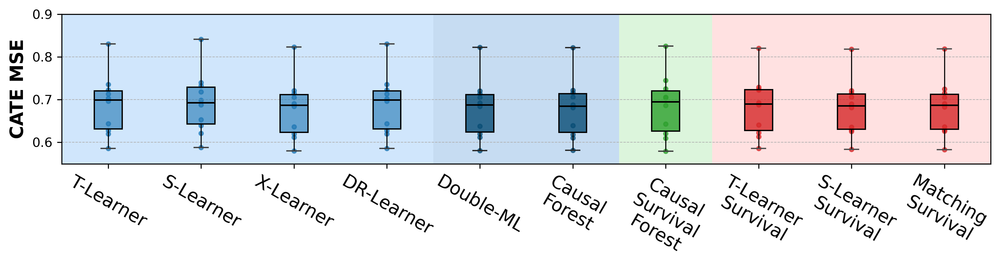

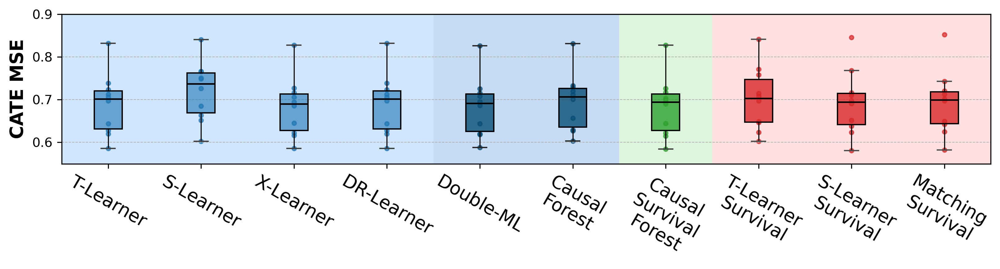

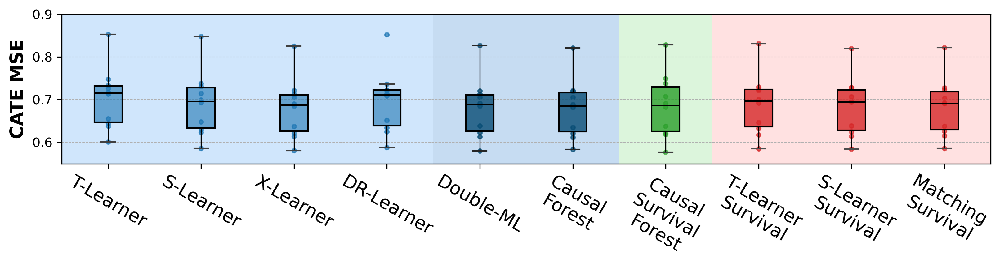

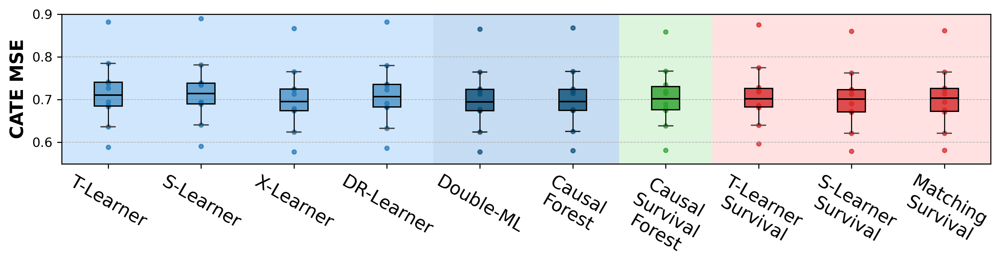

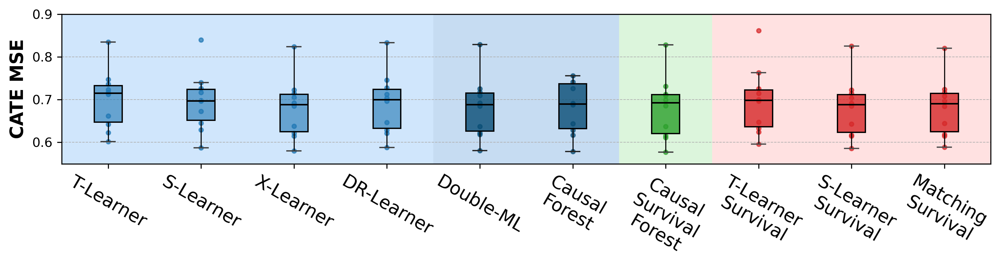

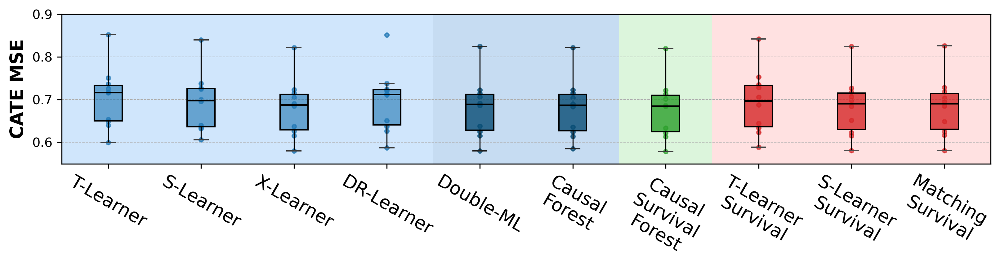

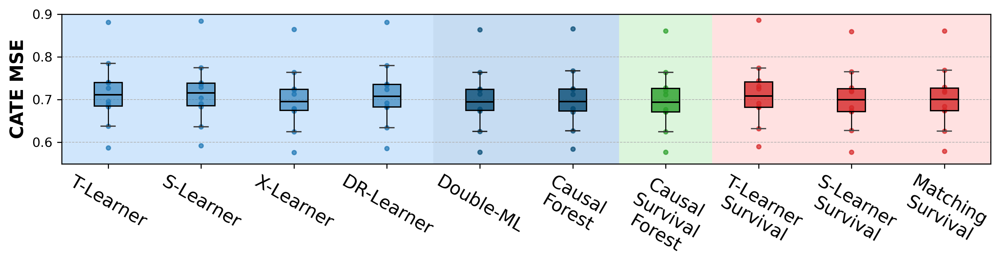

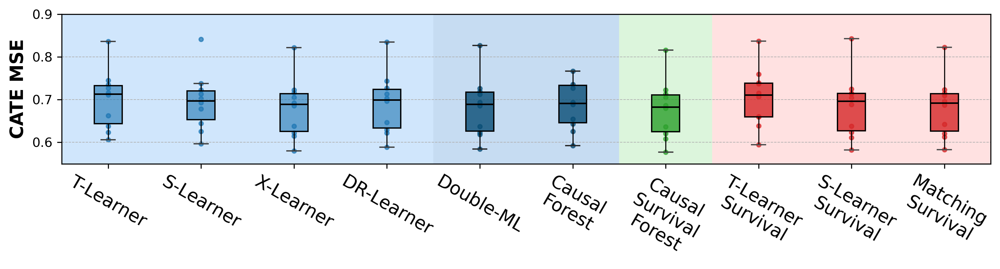

In [ ]:
# Set the scenario key
scenario_key = "scenario_B"

# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]
# metric = "cate_mse"  # Choose from ['cate_mse', 'ate_true', 'ate_pred', 'ate_bias']
# y_lim = None # Set to False to use individual y-limits for each plot or None for global limits
print(f"Scenario: {scenario_key}")

y_lim = Y_LIM.get(metric, {}).get(scenario_key, None)

df_plot = aggregated_results_df(aggregated_results, scenario_key, skip_experiments_list=skip_experiments_list)
plot_aggregated_experiment_results(scenario_key, df_plot, skip_experiments_list, metric=metric, y_lim=y_lim, title_include_scenario=False)

In [ ]:
# Set the scenario key
# scenario_key = "scenario_B"
# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]

df_plot = aggregated_results_df(aggregated_results, scenario_key, skip_experiments_list=skip_experiments_list)

print(f"Scenario: {scenario_key}")
pretty_results_table(df_plot)

Scenario: scenario_1


,experiment_id,experiment,method,best_imputation,best_base_model,best_base_survival,cate_mse,ate_bias
0,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",T-Learner,Margin,lasso,,0.688 ± 0.071,-0.025 ± 0.012
1,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",S-Learner,Margin,xgb,,0.692 ± 0.072,-0.036 ± 0.009
2,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",X-Learner,Margin,lasso,,0.679 ± 0.070,-0.028 ± 0.009
3,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",DR-Learner,Margin,lasso,,0.688 ± 0.071,-0.024 ± 0.013
4,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",Double-ML,Margin,,,0.679 ± 0.070,-0.029 ± 0.009
...,...,...,...,...,...,...,...,...
75,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",Causal Forest,Margin,,,0.756 ± 0.246,-0.034 ± 0.026
76,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",Causal Survival Forest,,,,0.677 ± 0.069,-0.010 ± 0.011
77,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",T-Learner Survival,,,DeepSurv,0.705 ± 0.070,-0.085 ± 0.039
78,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",S-Learner Survival,,,DeepSurv,0.684 ± 0.075,-0.051 ± 0.019


## Scenario A

Scenario: scenario_2


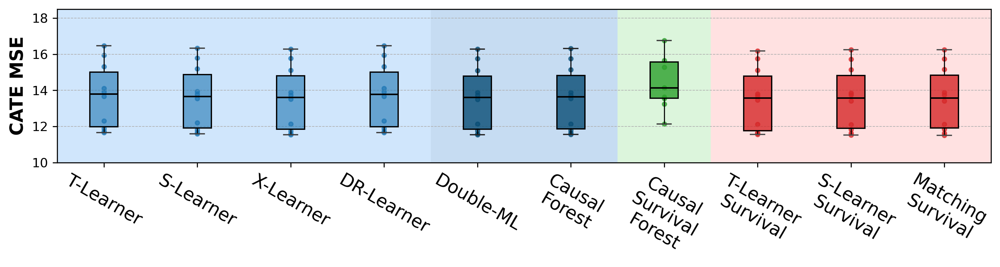

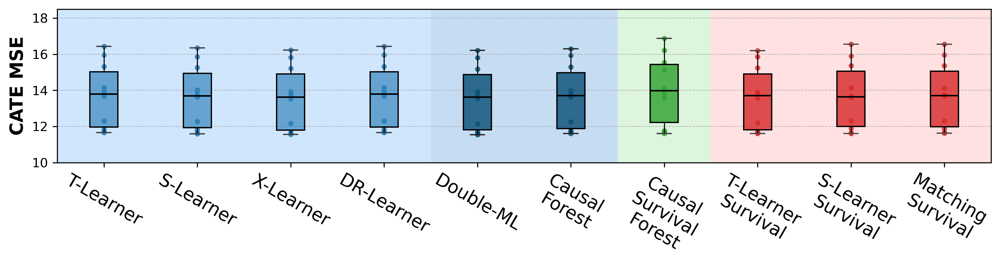

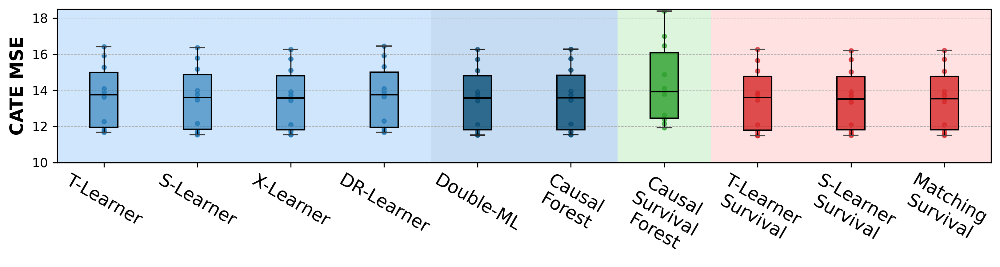

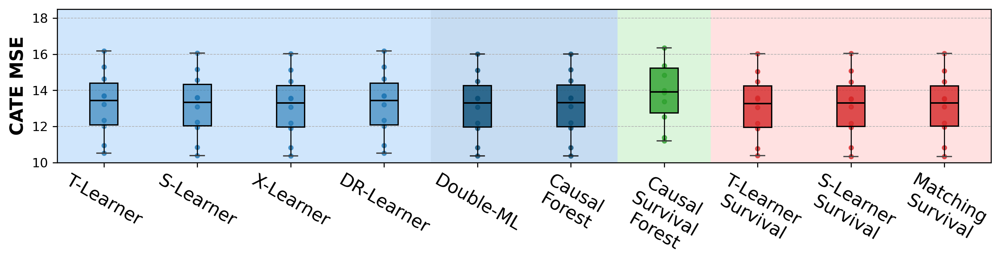

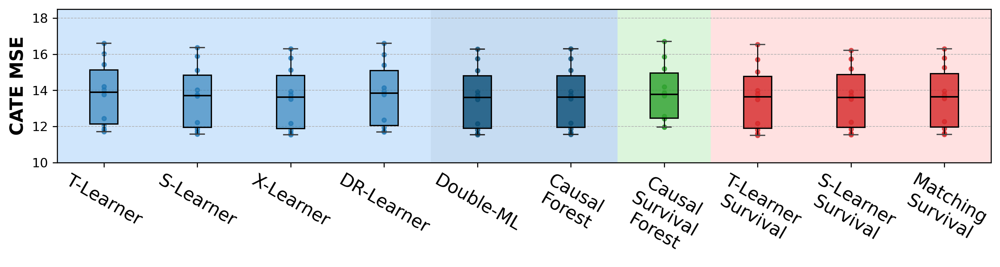

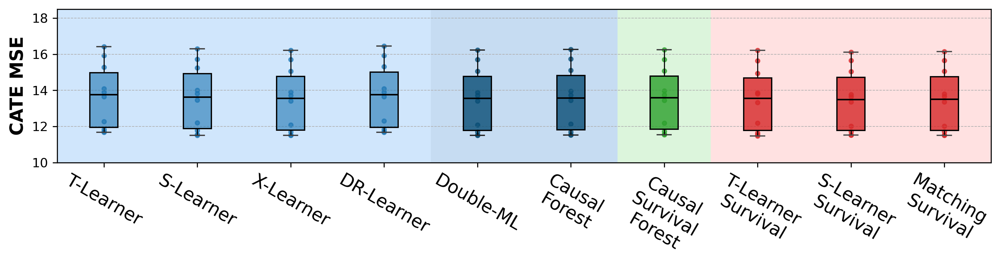

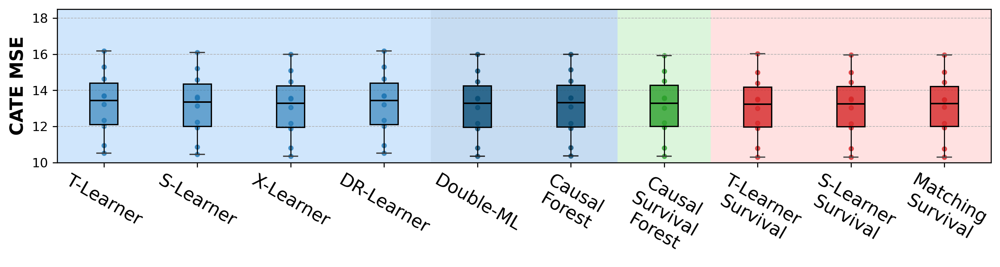

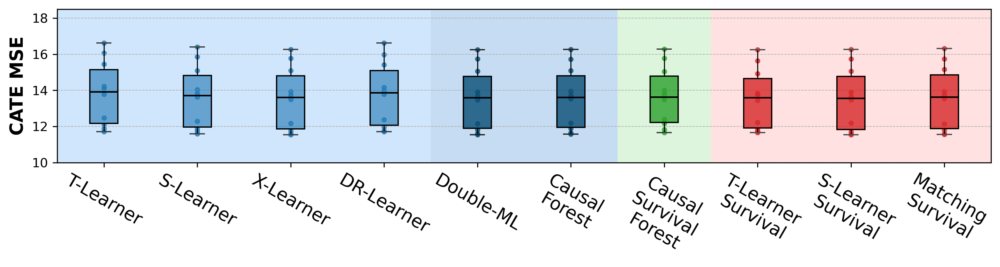

In [ ]:
# Set the scenario key
scenario_key = "scenario_A"

# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]
# metric = "cate_mse"  # Choose from ['cate_mse', 'ate_true', 'ate_pred', 'ate_bias']
# y_lim = None # Set to False to use individual y-limits for each plot or None for global limits
print(f"Scenario: {scenario_key}")

# y_lim = (10, 18.5)
y_lim = Y_LIM.get(metric, {}).get(scenario_key, None)

df_plot = aggregated_results_df(aggregated_results, scenario_key, skip_experiments_list=skip_experiments_list)
plot_aggregated_experiment_results(scenario_key, df_plot, skip_experiments_list, metric=metric, y_lim=y_lim, title_include_scenario=False)

In [ ]:
# Set the scenario key
# scenario_key = "scenario_A"
# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]

df_plot = aggregated_results_df(aggregated_results, scenario_key, skip_experiments_list=skip_experiments_list)

print(f"Scenario: {scenario_key}")
pretty_results_table(df_plot)

Scenario: scenario_2


,experiment_id,experiment,method,best_imputation,best_base_model,best_base_survival,cate_mse,ate_bias
0,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",T-Learner,Margin,lasso,,13.701 ± 1.790,-0.160 ± 0.018
1,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",S-Learner,Margin,xgb,,13.590 ± 1.763,-0.161 ± 0.022
2,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",X-Learner,Margin,lasso,,13.532 ± 1.768,-0.158 ± 0.018
3,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",DR-Learner,Margin,lasso,,13.701 ± 1.789,-0.159 ± 0.021
4,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",Double-ML,Margin,,,13.528 ± 1.764,-0.159 ± 0.018
...,...,...,...,...,...,...,...,...
75,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",Causal Forest,Margin,,,13.559 ± 1.732,-0.168 ± 0.035
76,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",Causal Survival Forest,,,,13.646 ± 1.656,-0.137 ± 0.112
77,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",T-Learner Survival,,,DeepSurv,13.529 ± 1.678,-0.161 ± 0.061
78,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",S-Learner Survival,,,DeepSurv,13.512 ± 1.755,-0.168 ± 0.035


## Scenario C

Scenario: scenario_5


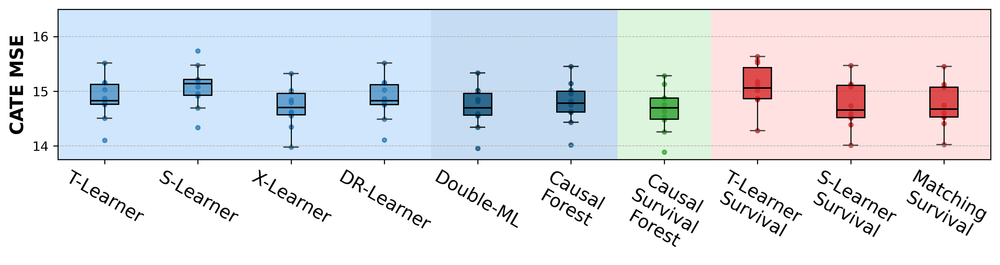

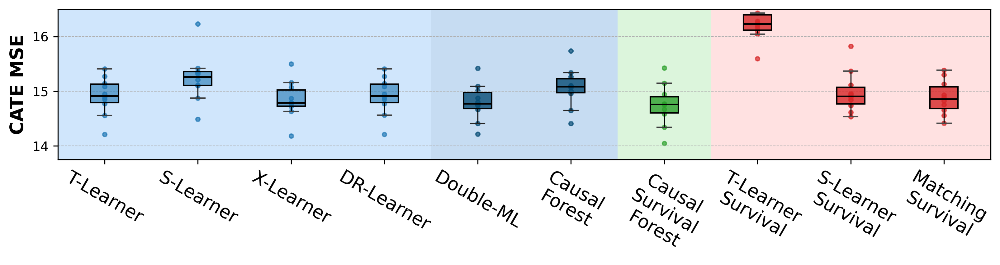

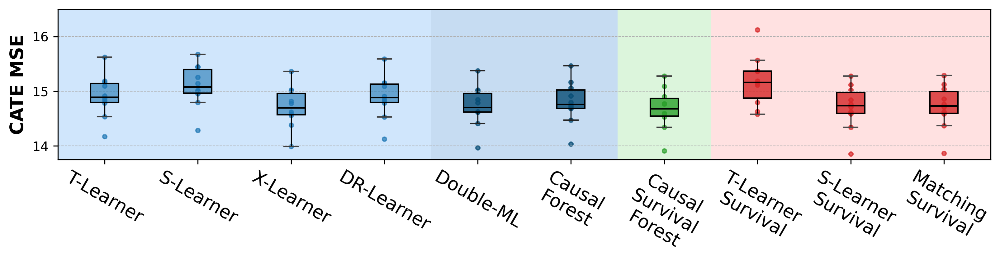

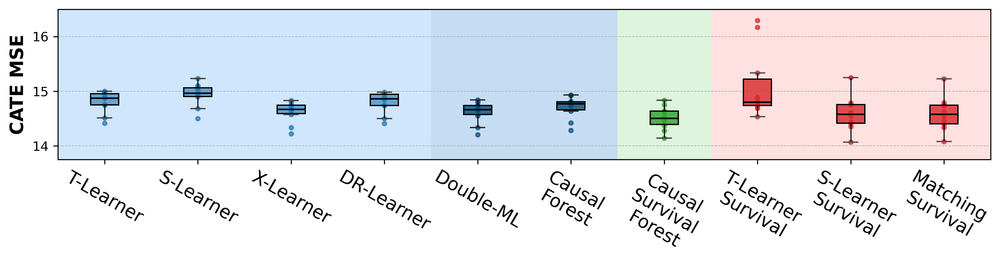

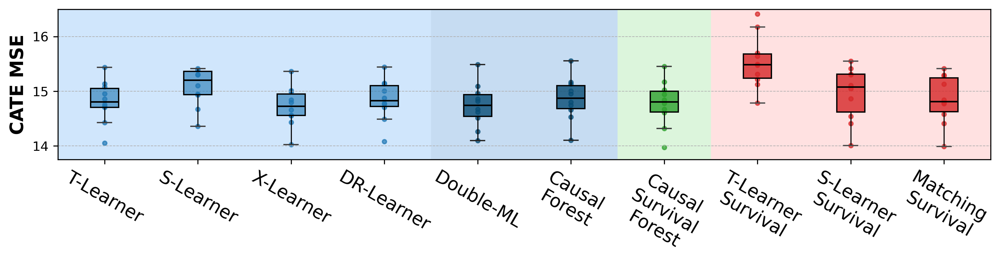

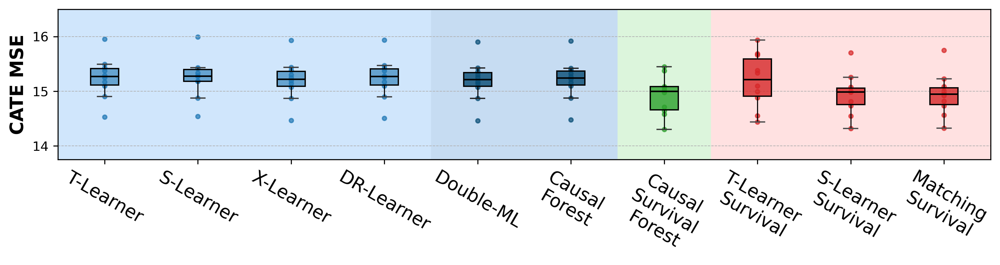

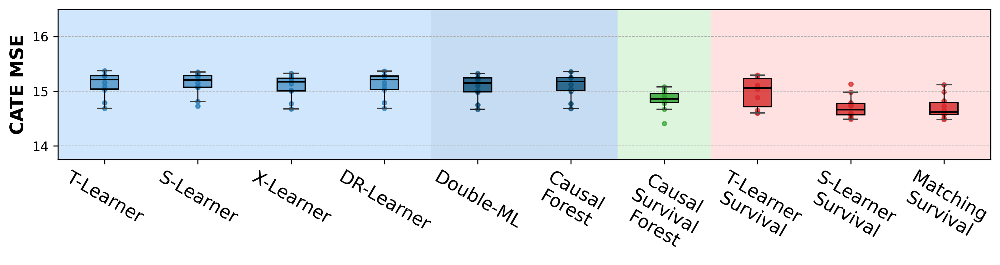

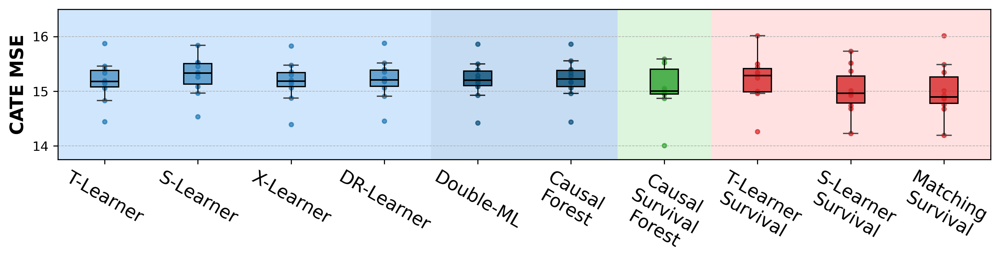

In [ ]:
# Set the scenario key
scenario_key = "scenario_C"

# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]
# metric = "cate_mse"  # Choose from ['cate_mse', 'ate_true', 'ate_pred', 'ate_bias']
# y_lim = None # Set to False to use individual y-limits for each plot or None for global limits
print(f"Scenario: {scenario_key}")

y_lim = Y_LIM.get(metric, {}).get(scenario_key, None)
# y_lim = (13.75, 16.25)

df_plot = aggregated_results_df(aggregated_results, scenario_key, skip_experiments_list=skip_experiments_list)
plot_aggregated_experiment_results(scenario_key, df_plot, skip_experiments_list, metric=metric, y_lim=y_lim, title_include_scenario=False)

In [ ]:
# Set the scenario key
# scenario_key = "scenario_C"
# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]

df_plot = aggregated_results_df(aggregated_results, scenario_key, skip_experiments_list=skip_experiments_list)

print(f"Scenario: {scenario_key}")
pretty_results_table(df_plot)

Scenario: scenario_5


,experiment_id,experiment,method,best_imputation,best_base_model,best_base_survival,cate_mse,ate_bias
0,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",T-Learner,Margin,lasso,,14.864 ± 0.388,-0.266 ± 0.054
1,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",S-Learner,Margin,xgb,,15.079 ± 0.394,-0.297 ± 0.054
2,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",X-Learner,Margin,lasso,,14.705 ± 0.378,-0.269 ± 0.051
3,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",DR-Learner,Margin,lasso,,14.860 ± 0.389,-0.259 ± 0.056
4,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",Double-ML,Margin,,,14.701 ± 0.388,-0.278 ± 0.050
...,...,...,...,...,...,...,...,...
75,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",Causal Forest,Margin,,,15.220 ± 0.378,-0.658 ± 0.036
76,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",Causal Survival Forest,,,,15.441 ± 1.480,-0.401 ± 0.507
77,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",T-Learner Survival,,,DeepSurv,15.206 ± 0.456,-0.218 ± 0.176
78,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",S-Learner Survival,,,DeepSurv,15.011 ± 0.436,0.007 ± 0.417


## Scenario E

Scenario: scenario_8


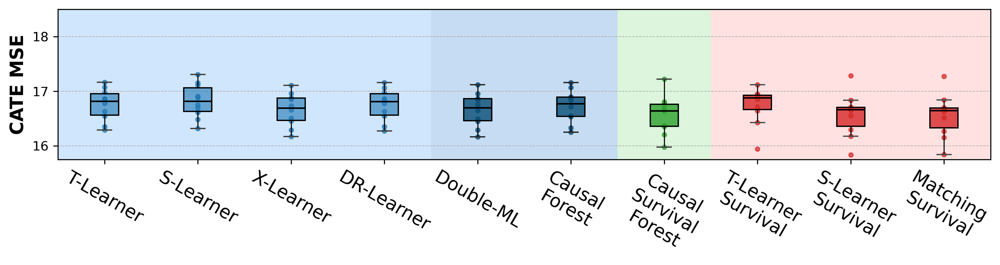

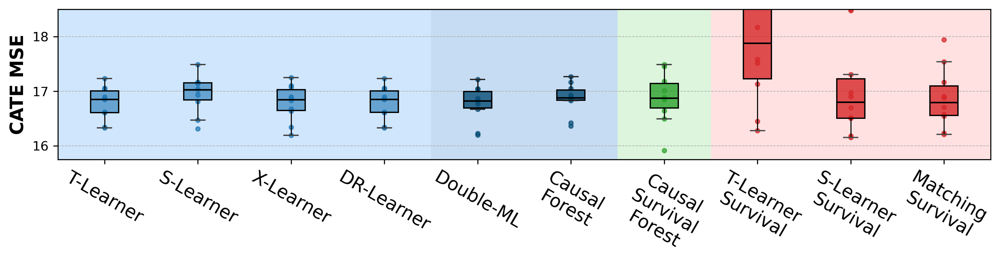

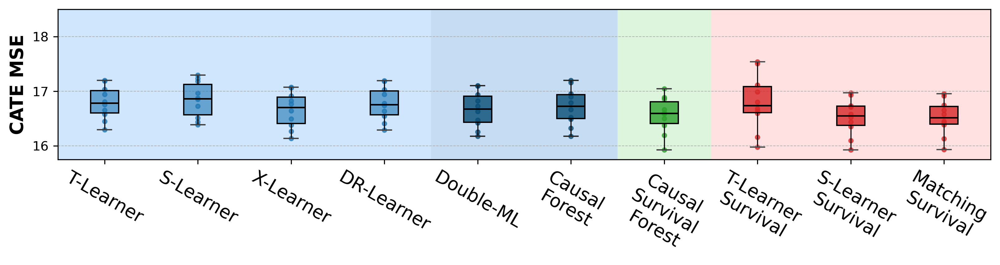

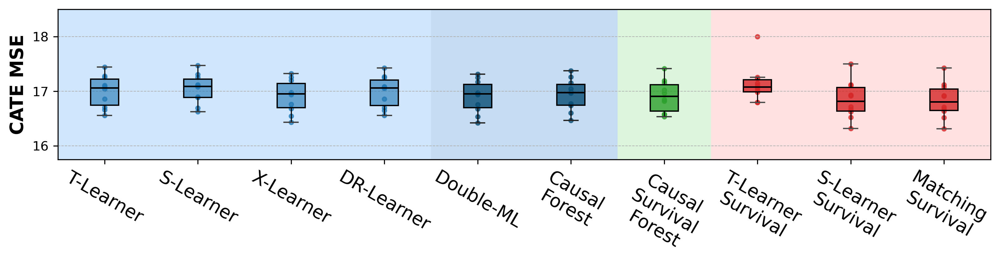

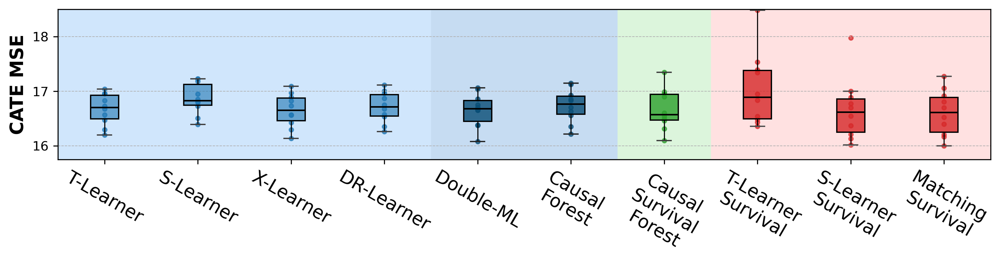

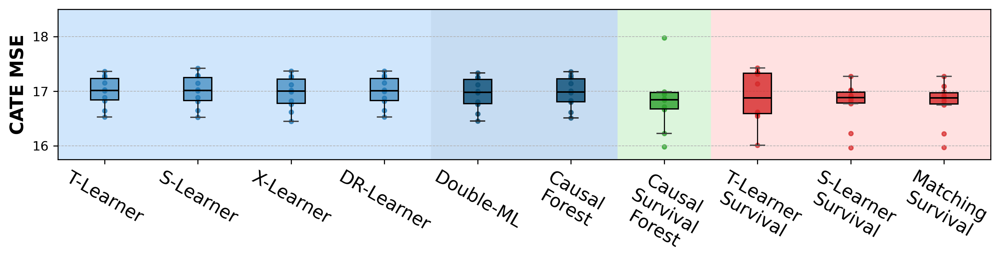

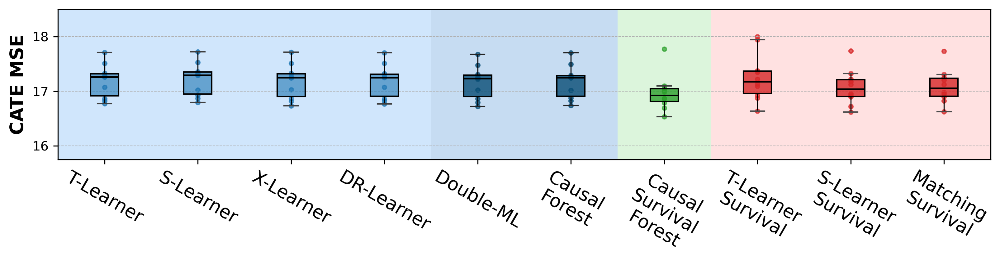

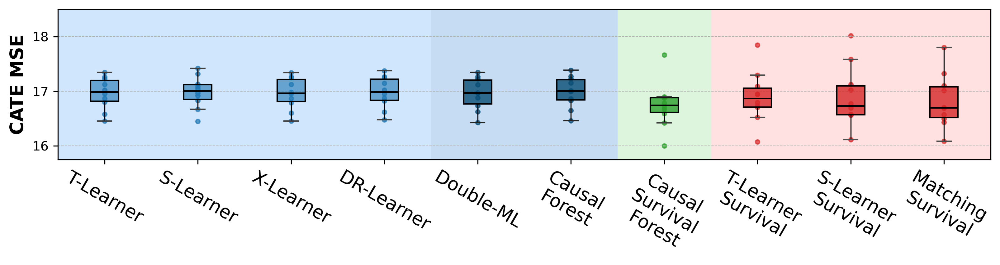

In [ ]:
# Set the scenario key
scenario_key = "scenario_E"

# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]
# metric = "cate_mse"  # Choose from ['cate_mse', 'ate_true', 'ate_pred', 'ate_bias']
# y_lim = None # Set to False to use individual y-limits for each plot or None for global limits
print(f"Scenario: {scenario_key}")

y_lim = Y_LIM.get(metric, {}).get(scenario_key, None)
# y_lim = (15.75, 18.75)

df_plot = aggregated_results_df(aggregated_results, scenario_key, skip_experiments_list=skip_experiments_list)
plot_aggregated_experiment_results(scenario_key, df_plot, skip_experiments_list, metric=metric, y_lim=y_lim, title_include_scenario=False)

In [ ]:
# Set the scenario key
# scenario_key = "scenario_E"
# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]

df_plot = aggregated_results_df(aggregated_results, scenario_key, skip_experiments_list=skip_experiments_list)

print(f"Scenario: {scenario_key}")
pretty_results_table(df_plot)

Scenario: scenario_8


,experiment_id,experiment,method,best_imputation,best_base_model,best_base_survival,cate_mse,ate_bias
0,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",T-Learner,Margin,lasso,,16.752 ± 0.295,-0.497 ± 0.053
1,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",S-Learner,Margin,xgb,,16.819 ± 0.312,-0.510 ± 0.059
2,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",X-Learner,Margin,lasso,,16.657 ± 0.303,-0.498 ± 0.054
3,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",DR-Learner,Margin,lasso,,16.746 ± 0.295,-0.491 ± 0.057
4,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",Double-ML,Margin,,,16.656 ± 0.305,-0.502 ± 0.053
...,...,...,...,...,...,...,...,...
75,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",Causal Forest,Margin,,,16.982 ± 0.291,-0.690 ± 0.031
76,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",Causal Survival Forest,,,,16.746 ± 0.421,-0.264 ± 0.479
77,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",T-Learner Survival,,,DeepSurv,16.893 ± 0.470,-0.119 ± 0.259
78,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",S-Learner Survival,,,DeepSurv,16.901 ± 0.556,-0.093 ± 0.465


## Scenario D

Scenario: scenario_9


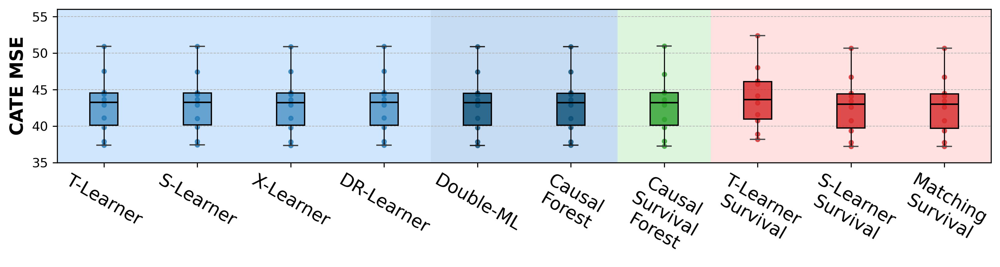

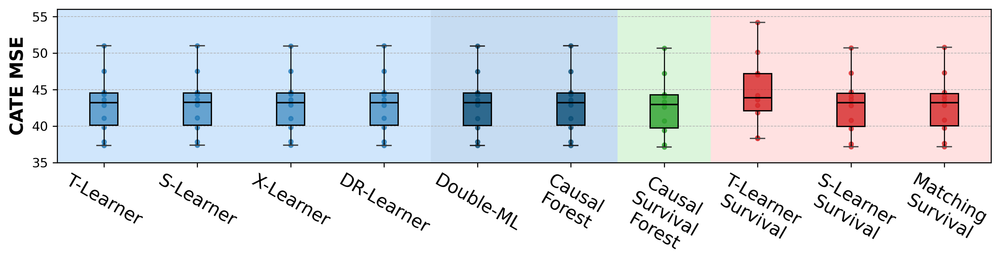

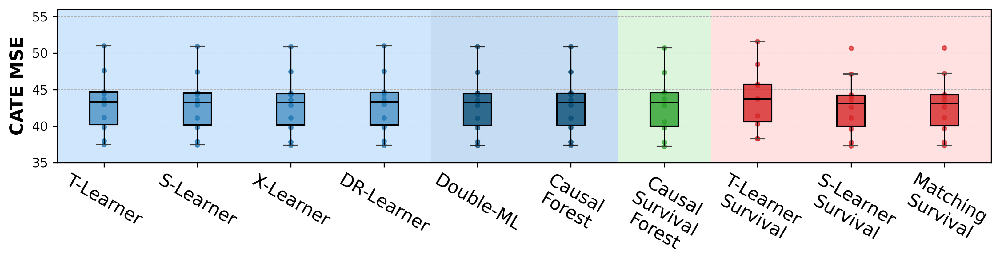

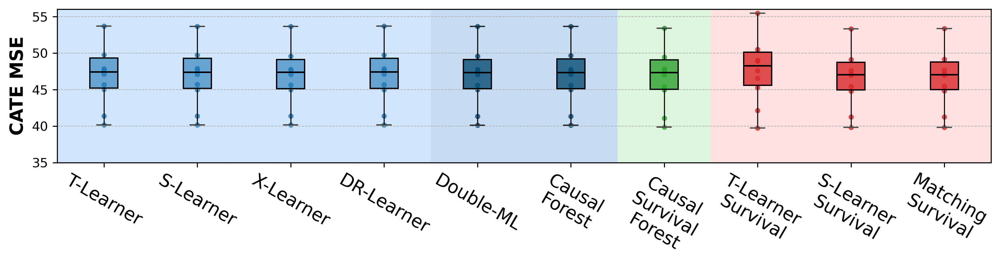

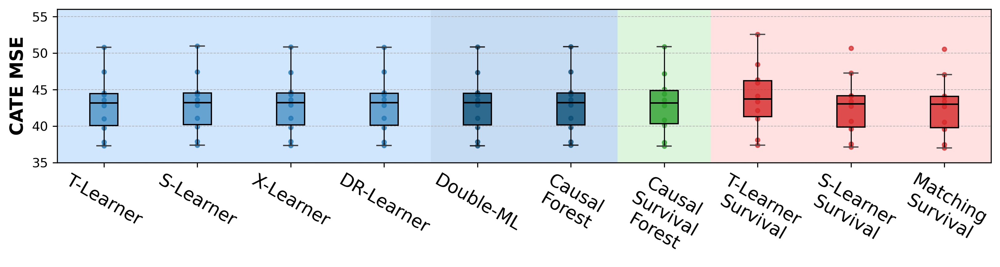

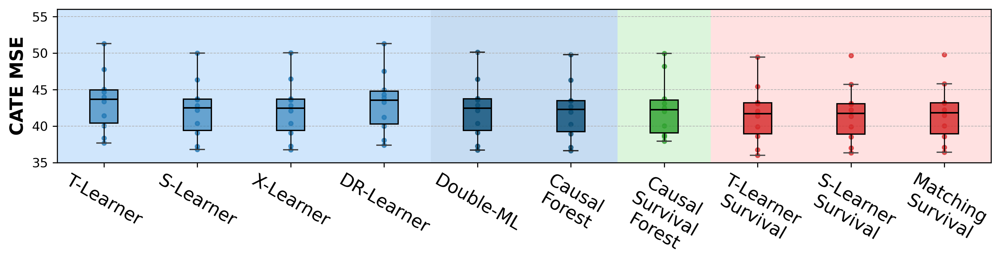

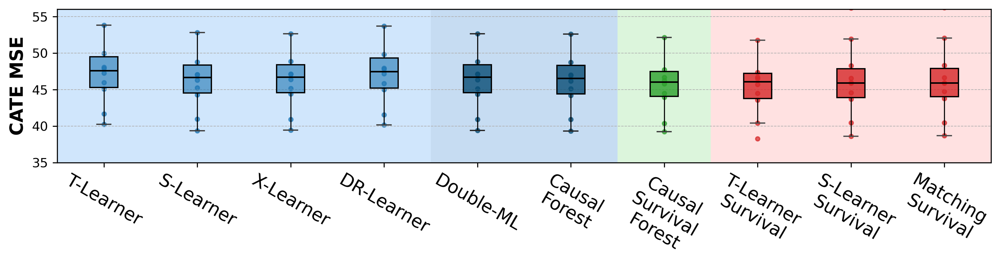

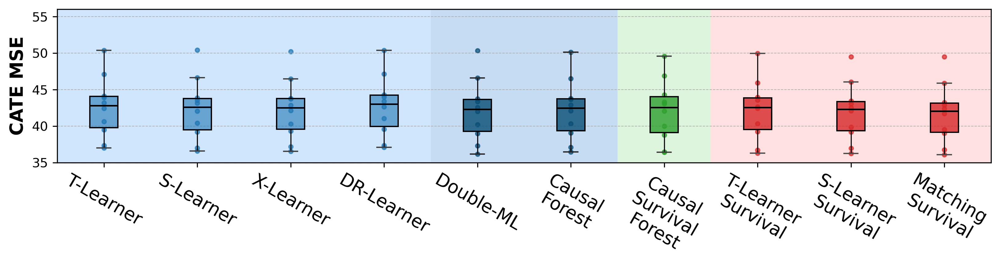

In [ ]:
# Set the scenario key
scenario_key = "scenario_D"

# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]
# metric = "cate_mse"  # Choose from ['cate_mse', 'ate_true', 'ate_pred', 'ate_bias']
# y_lim = None # Set to False to use i
# ndividual y-limits for each plot or None for global limits
# y_lim = (35, 56)
y_lim = Y_LIM.get(metric, {}).get(scenario_key, None)

print(f"Scenario: {scenario_key}")

df_plot = aggregated_results_df(aggregated_results, scenario_key, skip_experiments_list=skip_experiments_list)
plot_aggregated_experiment_results(scenario_key, df_plot, skip_experiments_list, metric=metric, y_lim=y_lim, title_include_scenario=False)

In [ ]:
# Set the scenario key
# scenario_key = "scenario_D"
# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]

df_plot = aggregated_results_df(aggregated_results, scenario_key, skip_experiments_list=skip_experiments_list)

print(f"Scenario: {scenario_key}")
pretty_results_table(df_plot)

Scenario: scenario_9


,experiment_id,experiment,method,best_imputation,best_base_model,best_base_survival,cate_mse,ate_bias
0,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",T-Learner,Margin,lasso,,43.004 ± 4.211,-0.746 ± 0.008
1,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",S-Learner,Margin,xgb,,42.993 ± 4.192,-0.756 ± 0.006
2,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",X-Learner,Margin,lasso,,42.976 ± 4.202,-0.747 ± 0.008
3,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",DR-Learner,Margin,lasso,,43.004 ± 4.211,-0.747 ± 0.007
4,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",Double-ML,Margin,,,42.959 ± 4.197,-0.747 ± 0.008
...,...,...,...,...,...,...,...,...
75,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",Causal Forest,Margin,,,42.181 ± 4.199,-0.716 ± 0.085
76,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",Causal Survival Forest,,,,42.079 ± 4.290,-0.545 ± 0.155
77,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",T-Learner Survival,,,DeepSurv,42.101 ± 4.166,-0.699 ± 0.110
78,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",S-Learner Survival,,,DeepSurv,41.890 ± 4.040,-0.718 ± 0.099


# ATE Bias

In [26]:
skip_experiments_list = [] #['RCT_0_5', 'RCT_0_05']
metric = "ate_bias"  # Choose from ['cate_mse', 'ate_true', 'ate_pred', 'ate_bias']

## Scenario B

Scenario: scenario_1


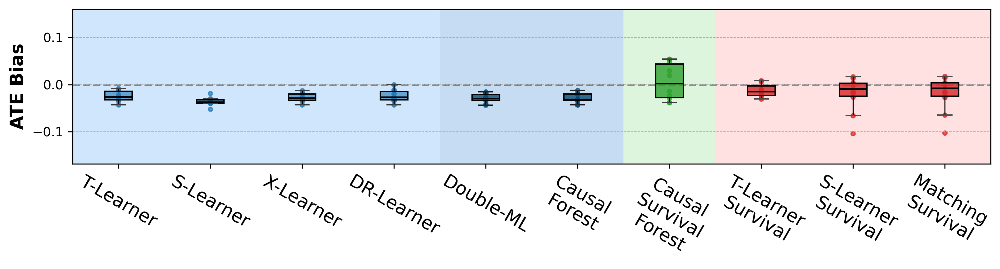

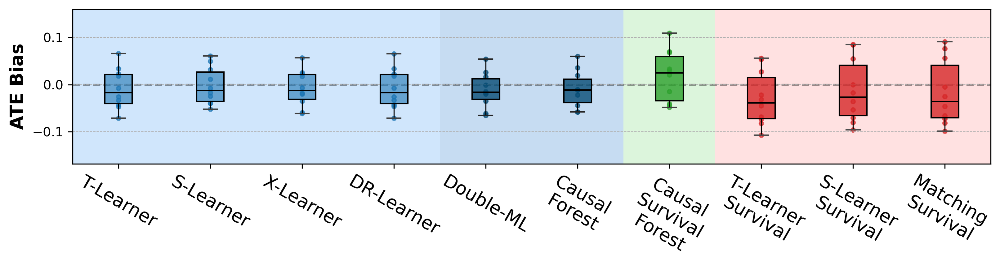

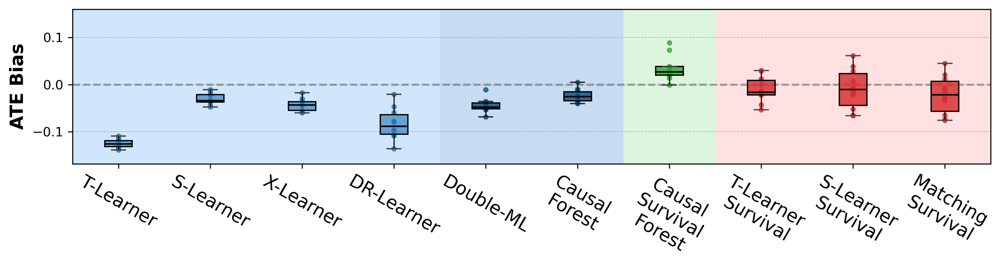

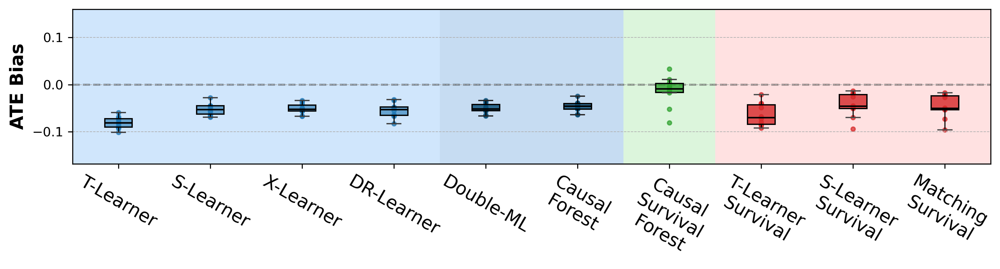

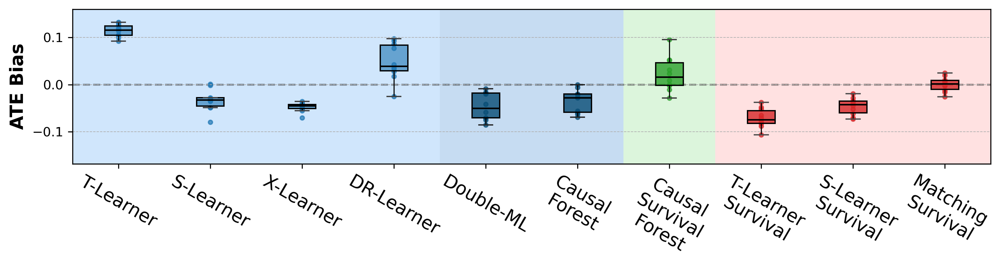

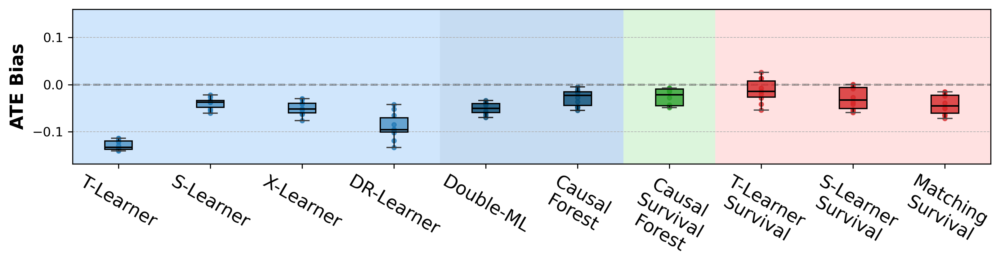

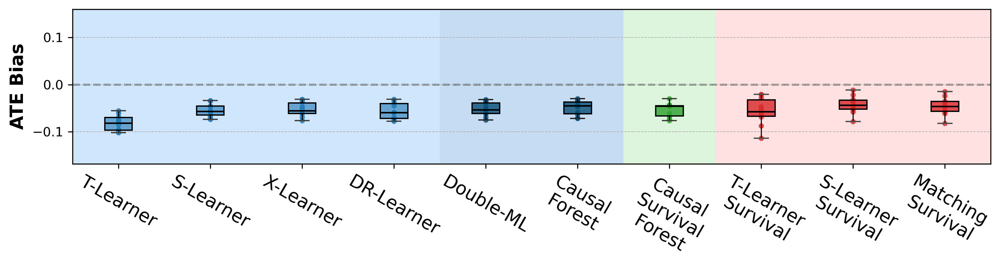

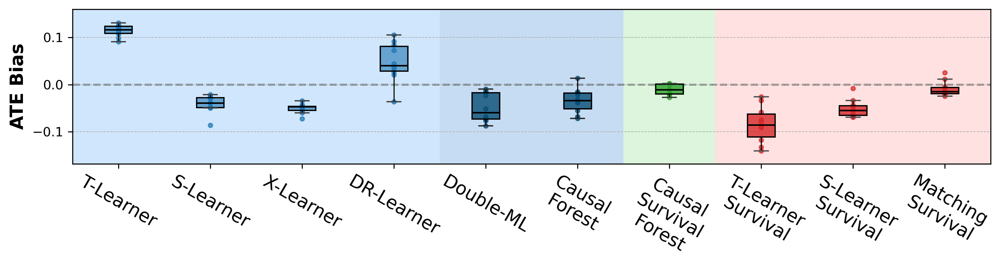

In [ ]:
# Set the scenario key
scenario_key = "scenario_B"

# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]
# metric = "cate_mse"  # Choose from ['cate_mse', 'ate_true', 'ate_pred', 'ate_bias']
# y_lim = None # Set to False to use individual y-limits for each plot or None for global limits
print(f"Scenario: {scenario_key}")

y_lim = Y_LIM.get(metric, {}).get(scenario_key, None)

df_plot = aggregated_results_df(aggregated_results, scenario_key, skip_experiments_list=skip_experiments_list)
plot_aggregated_experiment_results(scenario_key, df_plot, skip_experiments_list, metric=metric, y_lim=y_lim, title_include_scenario=False)

In [ ]:
# Set the scenario key
# scenario_key = "scenario_B"
# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]

df_plot = aggregated_results_df(aggregated_results, scenario_key, skip_experiments_list=skip_experiments_list)

print(f"Scenario: {scenario_key}")
pretty_results_table(df_plot)

Scenario: scenario_1


,experiment_id,experiment,method,best_imputation,best_base_model,best_base_survival,cate_mse,ate_bias
0,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",T-Learner,Margin,lasso,,0.688 ± 0.071,-0.025 ± 0.012
1,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",S-Learner,Margin,xgb,,0.692 ± 0.072,-0.036 ± 0.009
2,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",X-Learner,Margin,lasso,,0.679 ± 0.070,-0.028 ± 0.009
3,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",DR-Learner,Margin,lasso,,0.688 ± 0.071,-0.024 ± 0.013
4,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",Double-ML,Margin,,,0.679 ± 0.070,-0.029 ± 0.009
...,...,...,...,...,...,...,...,...
75,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",Causal Forest,Margin,,,0.756 ± 0.246,-0.034 ± 0.026
76,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",Causal Survival Forest,,,,0.677 ± 0.069,-0.010 ± 0.011
77,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",T-Learner Survival,,,DeepSurv,0.705 ± 0.070,-0.085 ± 0.039
78,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",S-Learner Survival,,,DeepSurv,0.684 ± 0.075,-0.051 ± 0.019


## Scenario A

Scenario: scenario_2


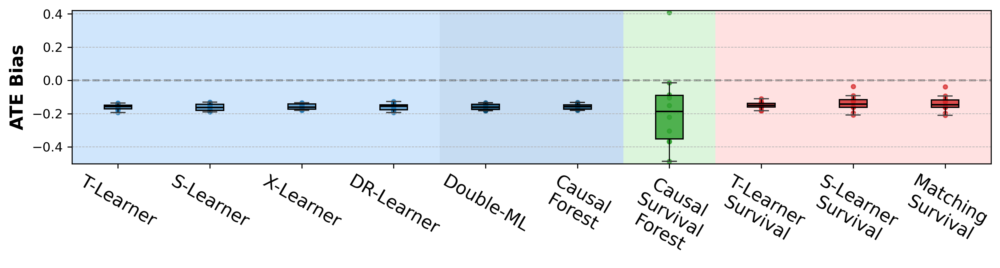

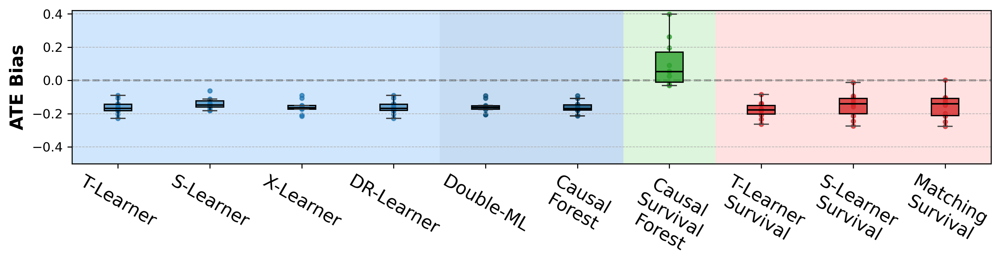

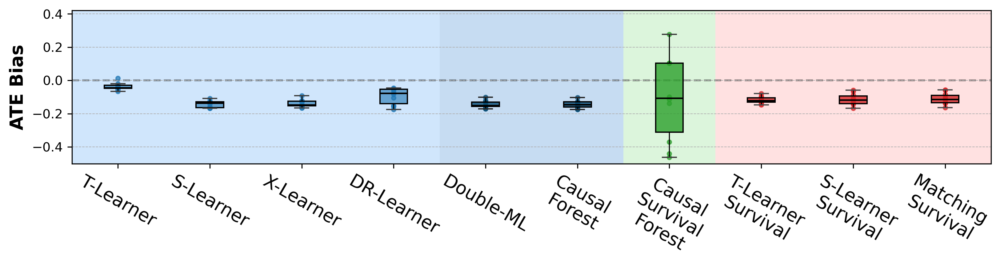

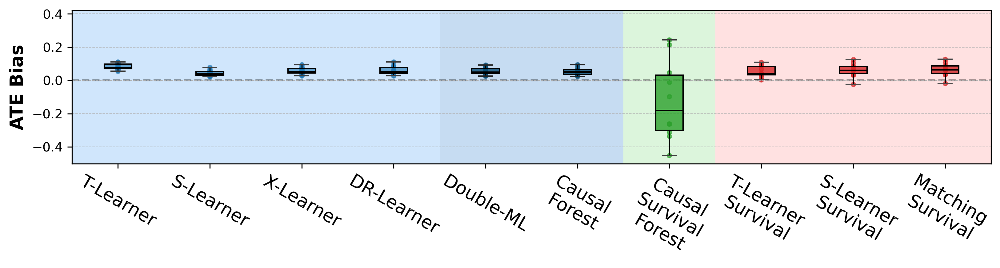

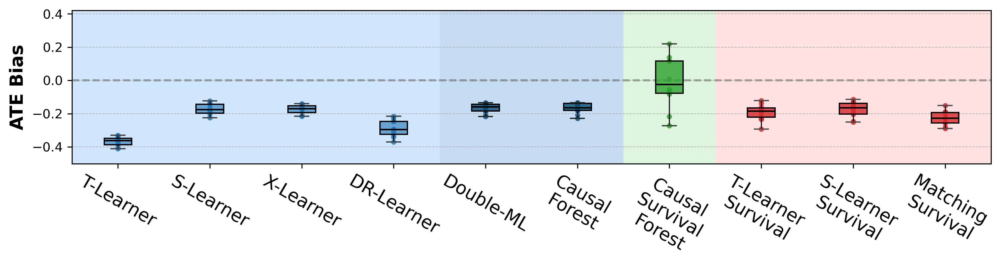

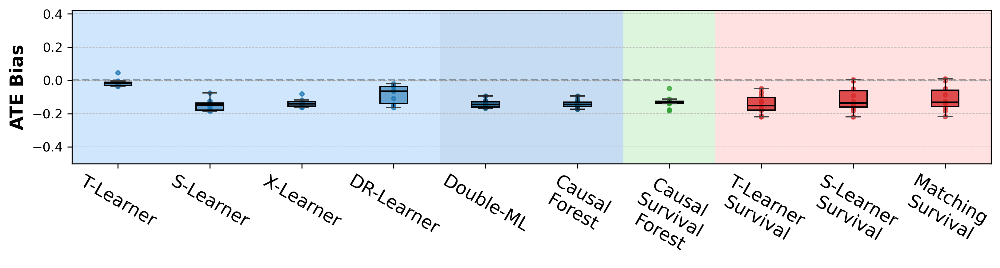

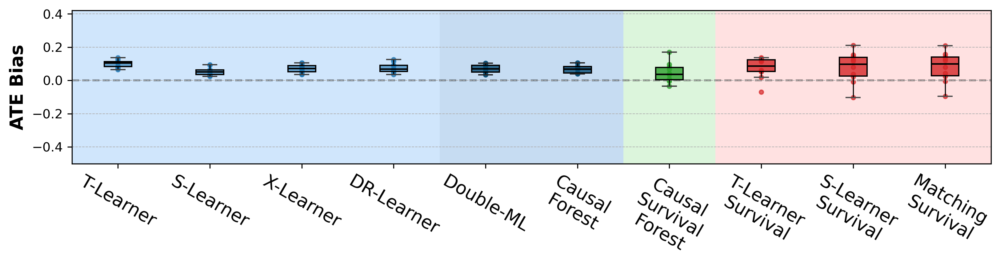

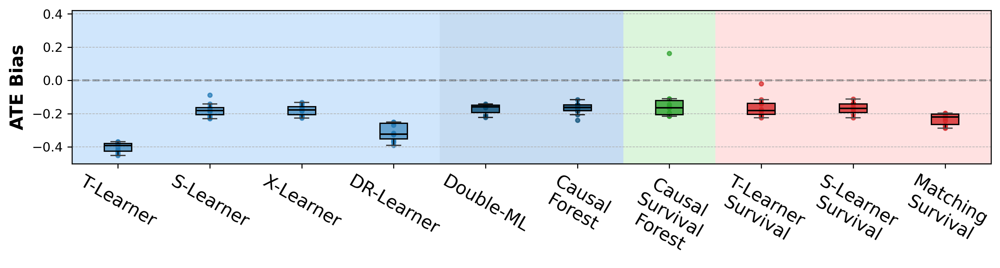

In [ ]:
# Set the scenario key
scenario_key = "scenario_A"

# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]
# metric = "cate_mse"  # Choose from ['cate_mse', 'ate_true', 'ate_pred', 'ate_bias']
# y_lim = None # Set to False to use individual y-limits for each plot or None for global limits
print(f"Scenario: {scenario_key}")

# y_lim = (10, 18.5)
y_lim = Y_LIM.get(metric, {}).get(scenario_key, None)

df_plot = aggregated_results_df(aggregated_results, scenario_key, skip_experiments_list=skip_experiments_list)
plot_aggregated_experiment_results(scenario_key, df_plot, skip_experiments_list, metric=metric, y_lim=y_lim, title_include_scenario=False)

In [ ]:
# Set the scenario key
# scenario_key = "scenario_A"
# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]

df_plot = aggregated_results_df(aggregated_results, scenario_key, skip_experiments_list=skip_experiments_list)

print(f"Scenario: {scenario_key}")
pretty_results_table(df_plot)

Scenario: scenario_2


,experiment_id,experiment,method,best_imputation,best_base_model,best_base_survival,cate_mse,ate_bias
0,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",T-Learner,Margin,lasso,,13.701 ± 1.790,-0.160 ± 0.018
1,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",S-Learner,Margin,xgb,,13.590 ± 1.763,-0.161 ± 0.022
2,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",X-Learner,Margin,lasso,,13.532 ± 1.768,-0.158 ± 0.018
3,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",DR-Learner,Margin,lasso,,13.701 ± 1.789,-0.159 ± 0.021
4,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",Double-ML,Margin,,,13.528 ± 1.764,-0.159 ± 0.018
...,...,...,...,...,...,...,...,...
75,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",Causal Forest,Margin,,,13.559 ± 1.732,-0.168 ± 0.035
76,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",Causal Survival Forest,,,,13.646 ± 1.656,-0.137 ± 0.112
77,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",T-Learner Survival,,,DeepSurv,13.529 ± 1.678,-0.161 ± 0.061
78,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",S-Learner Survival,,,DeepSurv,13.512 ± 1.755,-0.168 ± 0.035


## Scenario C

Scenario: scenario_5


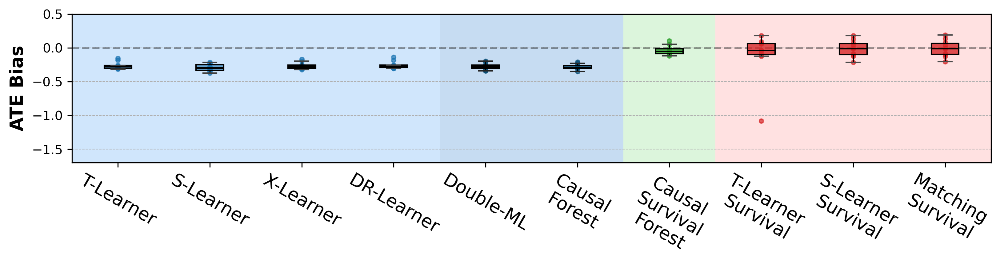

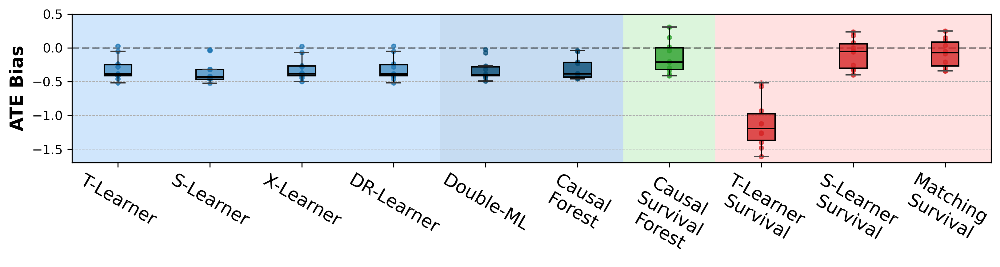

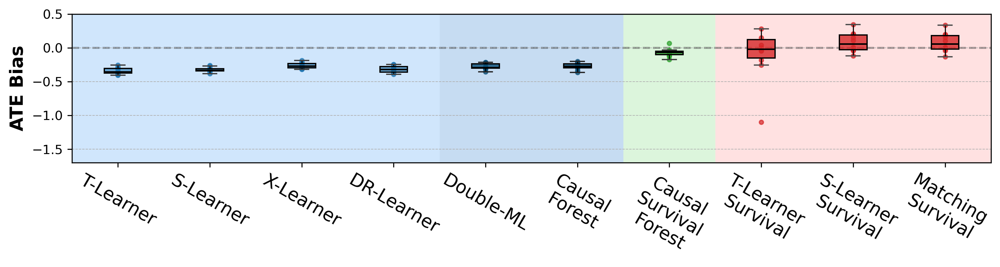

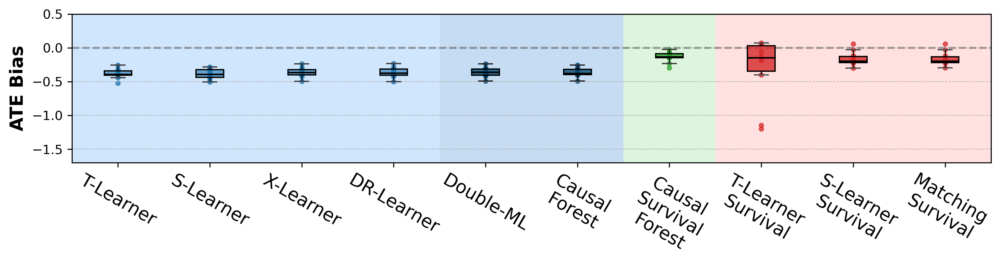

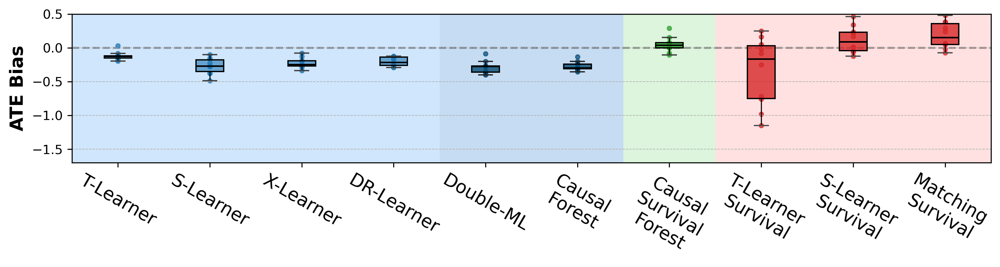

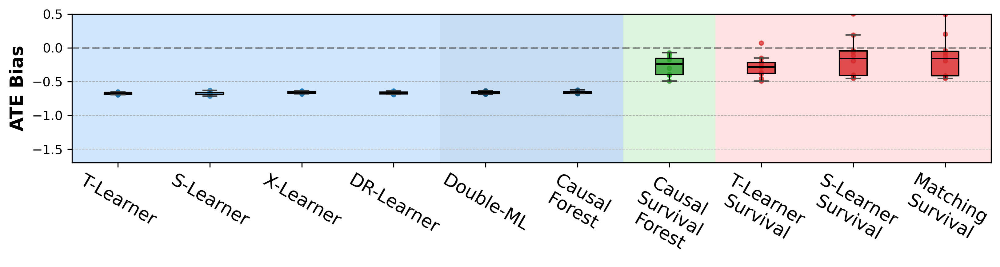

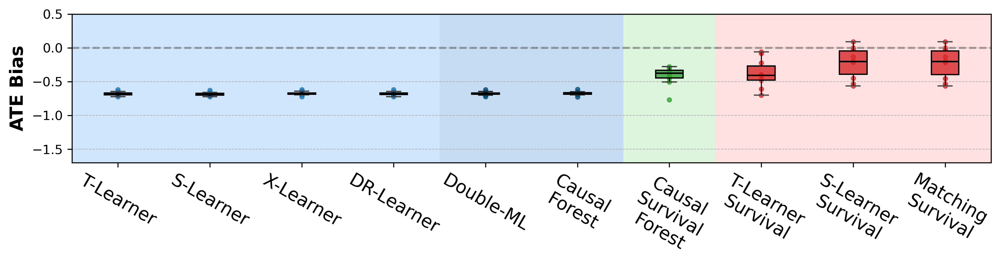

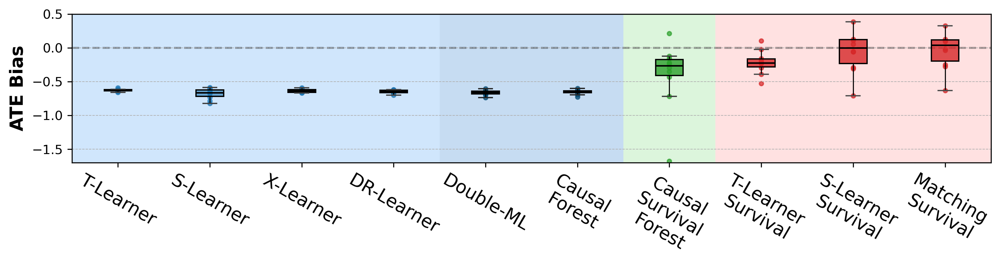

In [ ]:
# Set the scenario key
scenario_key = "scenario_C"

# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]
# metric = "cate_mse"  # Choose from ['cate_mse', 'ate_true', 'ate_pred', 'ate_bias']
# y_lim = None # Set to False to use individual y-limits for each plot or None for global limits
print(f"Scenario: {scenario_key}")

y_lim = Y_LIM.get(metric, {}).get(scenario_key, None)
# y_lim = (13.75, 16.25)

df_plot = aggregated_results_df(aggregated_results, scenario_key, skip_experiments_list=skip_experiments_list)
plot_aggregated_experiment_results(scenario_key, df_plot, skip_experiments_list, metric=metric, y_lim=y_lim, title_include_scenario=False)

In [ ]:
# Set the scenario key
# scenario_key = "scenario_C"
# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]

df_plot = aggregated_results_df(aggregated_results, scenario_key, skip_experiments_list=skip_experiments_list)

print(f"Scenario: {scenario_key}")
pretty_results_table(df_plot)

Scenario: scenario_5


,experiment_id,experiment,method,best_imputation,best_base_model,best_base_survival,cate_mse,ate_bias
0,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",T-Learner,Margin,lasso,,14.864 ± 0.388,-0.266 ± 0.054
1,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",S-Learner,Margin,xgb,,15.079 ± 0.394,-0.297 ± 0.054
2,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",X-Learner,Margin,lasso,,14.705 ± 0.378,-0.269 ± 0.051
3,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",DR-Learner,Margin,lasso,,14.860 ± 0.389,-0.259 ± 0.056
4,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",Double-ML,Margin,,,14.701 ± 0.388,-0.278 ± 0.050
...,...,...,...,...,...,...,...,...
75,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",Causal Forest,Margin,,,15.220 ± 0.378,-0.658 ± 0.036
76,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",Causal Survival Forest,,,,15.441 ± 1.480,-0.401 ± 0.507
77,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",T-Learner Survival,,,DeepSurv,15.206 ± 0.456,-0.218 ± 0.176
78,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",S-Learner Survival,,,DeepSurv,15.011 ± 0.436,0.007 ± 0.417


## Scenario E

Scenario: scenario_8


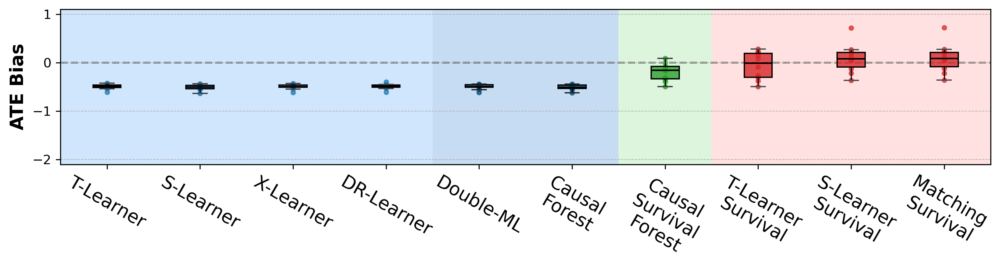

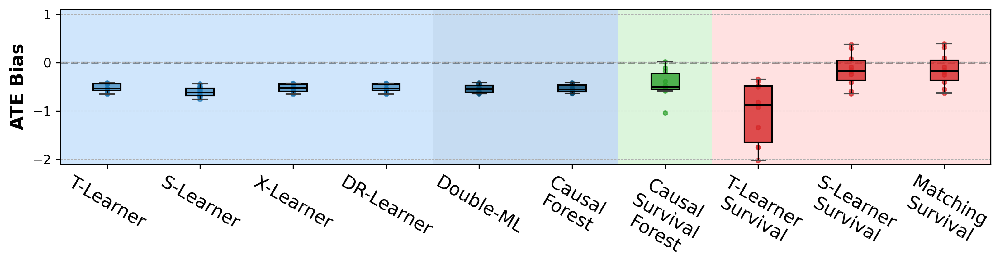

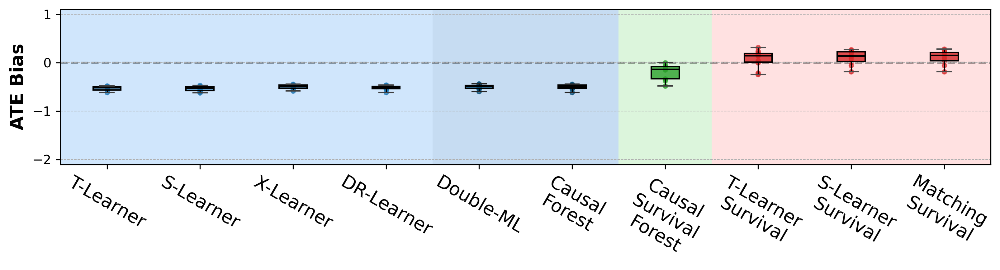

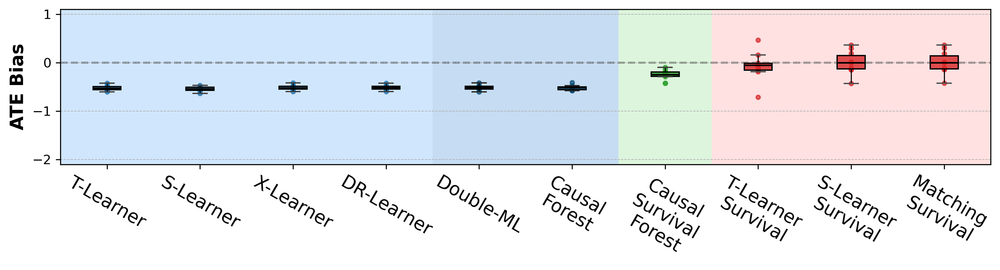

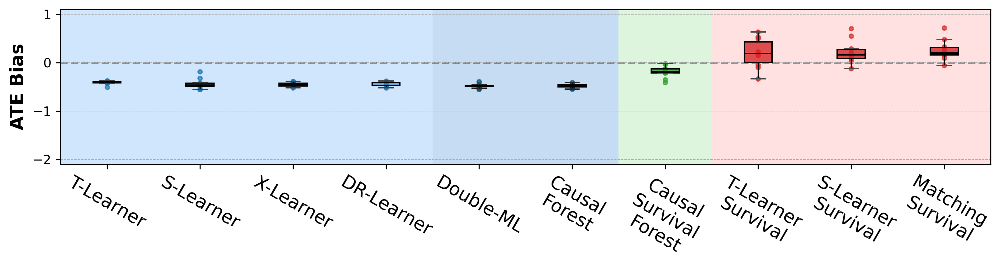

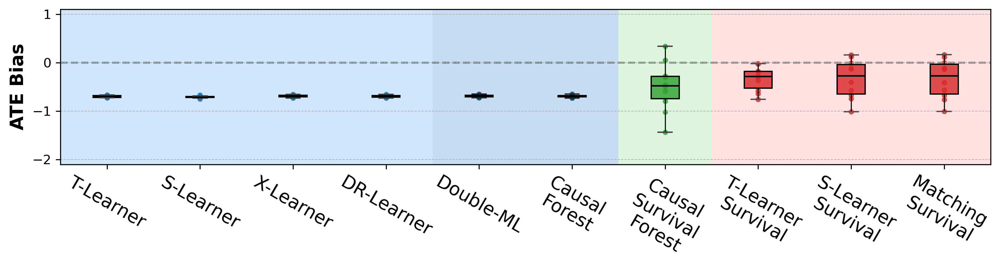

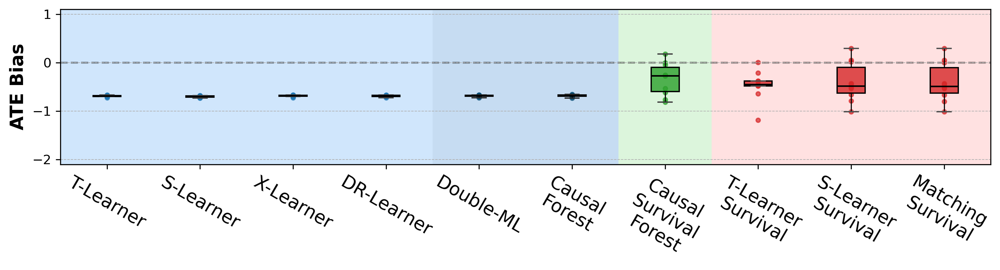

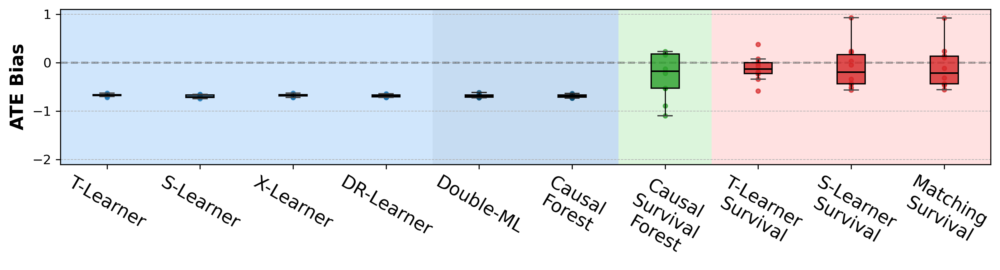

In [ ]:
# Set the scenario key
scenario_key = "scenario_E"

# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]
# metric = "cate_mse"  # Choose from ['cate_mse', 'ate_true', 'ate_pred', 'ate_bias']
# y_lim = None # Set to False to use individual y-limits for each plot or None for global limits
print(f"Scenario: {scenario_key}")

y_lim = Y_LIM.get(metric, {}).get(scenario_key, None)
# y_lim = (15.75, 18.75)

df_plot = aggregated_results_df(aggregated_results, scenario_key, skip_experiments_list=skip_experiments_list)
plot_aggregated_experiment_results(scenario_key, df_plot, skip_experiments_list, metric=metric, y_lim=y_lim, title_include_scenario=False)

In [ ]:
# Set the scenario key
# scenario_key = "scenario_E"
# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]

df_plot = aggregated_results_df(aggregated_results, scenario_key, skip_experiments_list=skip_experiments_list)

print(f"Scenario: {scenario_key}")
pretty_results_table(df_plot)

Scenario: scenario_8


,experiment_id,experiment,method,best_imputation,best_base_model,best_base_survival,cate_mse,ate_bias
0,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",T-Learner,Margin,lasso,,16.752 ± 0.295,-0.497 ± 0.053
1,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",S-Learner,Margin,xgb,,16.819 ± 0.312,-0.510 ± 0.059
2,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",X-Learner,Margin,lasso,,16.657 ± 0.303,-0.498 ± 0.054
3,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",DR-Learner,Margin,lasso,,16.746 ± 0.295,-0.491 ± 0.057
4,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",Double-ML,Margin,,,16.656 ± 0.305,-0.502 ± 0.053
...,...,...,...,...,...,...,...,...
75,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",Causal Forest,Margin,,,16.982 ± 0.291,-0.690 ± 0.031
76,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",Causal Survival Forest,,,,16.746 ± 0.421,-0.264 ± 0.479
77,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",T-Learner Survival,,,DeepSurv,16.893 ± 0.470,-0.119 ± 0.259
78,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",S-Learner Survival,,,DeepSurv,16.901 ± 0.556,-0.093 ± 0.465


## Scenario D

Scenario: scenario_9


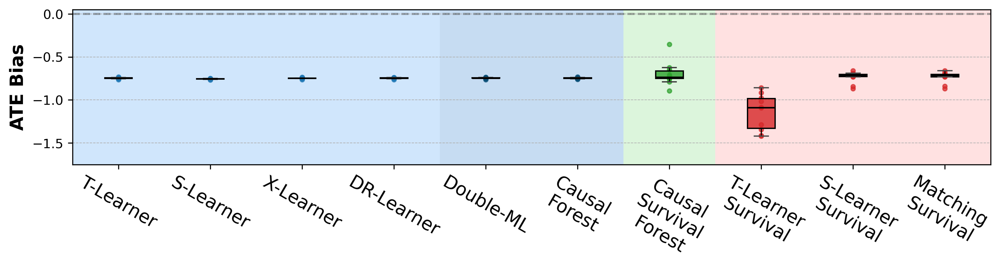

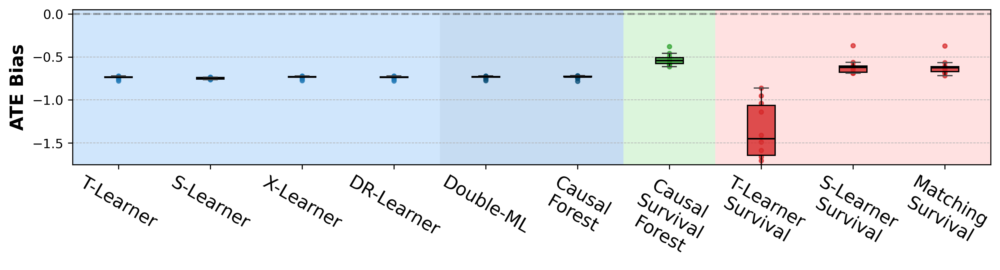

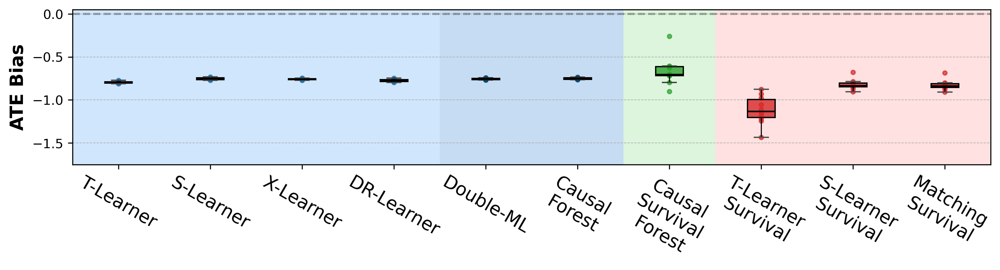

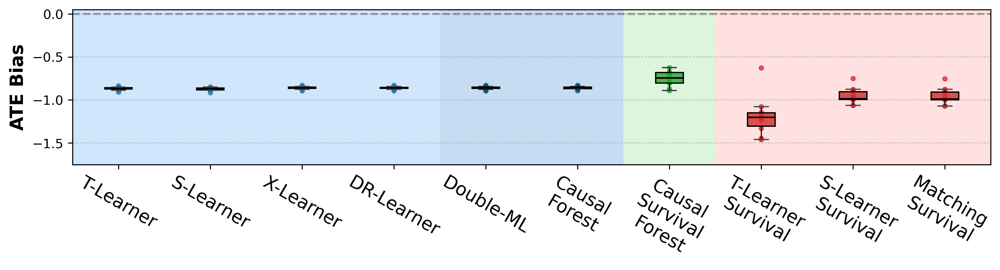

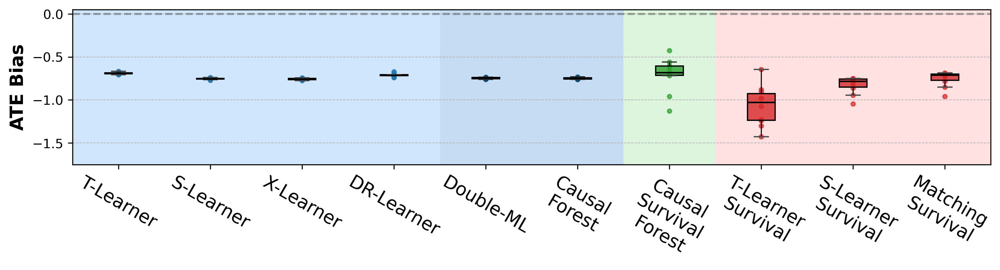

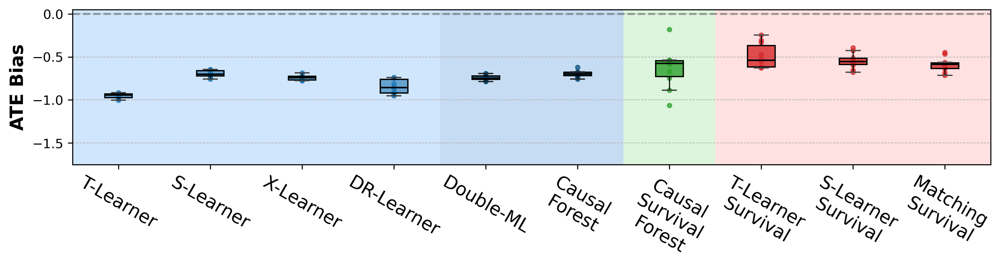

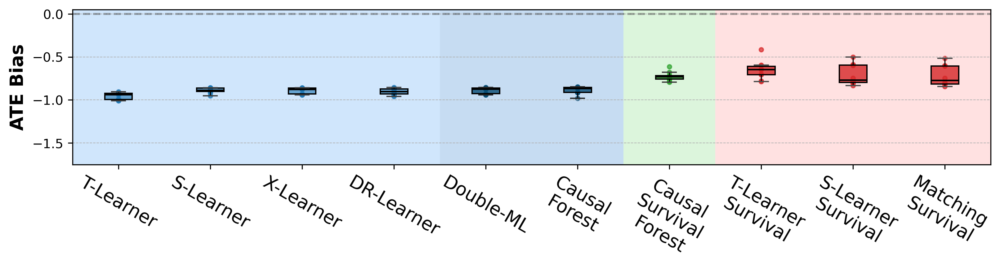

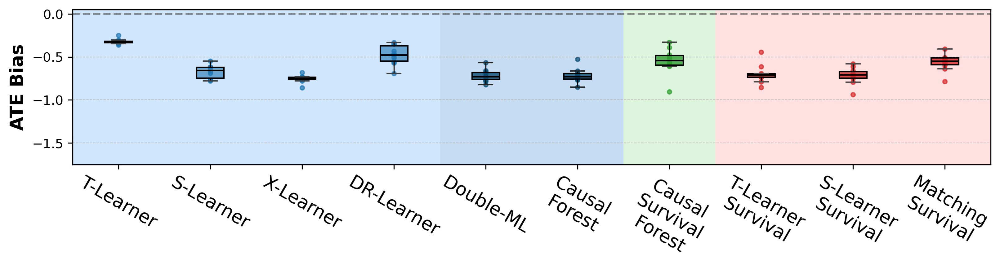

In [ ]:
# Set the scenario key
scenario_key = "scenario_D"

# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]
# metric = "cate_mse"  # Choose from ['cate_mse', 'ate_true', 'ate_pred', 'ate_bias']
# y_lim = None # Set to False to use i
# ndividual y-limits for each plot or None for global limits
# y_lim = (35, 56)
y_lim = Y_LIM.get(metric, {}).get(scenario_key, None)

print(f"Scenario: {scenario_key}")

df_plot = aggregated_results_df(aggregated_results, scenario_key, skip_experiments_list=skip_experiments_list)
plot_aggregated_experiment_results(scenario_key, df_plot, skip_experiments_list, metric=metric, y_lim=y_lim, title_include_scenario=False)

In [ ]:
# Set the scenario key
# scenario_key = "scenario_D"
# skip_experiments_list = ["RCT_0_5", "RCT_0_05"]

df_plot = aggregated_results_df(aggregated_results, scenario_key, skip_experiments_list=skip_experiments_list)

print(f"Scenario: {scenario_key}")
pretty_results_table(df_plot)

Scenario: scenario_9


,experiment_id,experiment,method,best_imputation,best_base_model,best_base_survival,cate_mse,ate_bias
0,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",T-Learner,Margin,lasso,,43.004 ± 4.211,-0.746 ± 0.008
1,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",S-Learner,Margin,xgb,,42.993 ± 4.192,-0.756 ± 0.006
2,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",X-Learner,Margin,lasso,,42.976 ± 4.202,-0.747 ± 0.008
3,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",DR-Learner,Margin,lasso,,43.004 ± 4.211,-0.747 ± 0.007
4,RCT_0_5,"RCT: ✓ (50%), Ignorability: ✓, Positivity: ✓, Ignorable Censoring: ✓",Double-ML,Margin,,,42.959 ± 4.197,-0.747 ± 0.008
...,...,...,...,...,...,...,...,...
75,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",Causal Forest,Margin,,,42.181 ± 4.199,-0.716 ± 0.085
76,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",Causal Survival Forest,,,,42.079 ± 4.290,-0.545 ± 0.155
77,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",T-Learner Survival,,,DeepSurv,42.101 ± 4.166,-0.699 ± 0.110
78,e_X_no_overlap_info_censor,"RCT: ✗, Ignorability: ✓, Positivity: ✗, Ignorable Censoring: ✗",S-Learner Survival,,,DeepSurv,41.890 ± 4.040,-0.718 ± 0.099
